In [1]:
# 기존 cv2 제거
!pip uninstall -y opencv-python

# 새로 설치 (headless 버전 - GUI 관련 의존성 없음)
!pip uninstall -y opencv-python opencv-python-headless
!pip install opencv-python-headless

# 필요한 모든 패키지 설치
!pip install numpy pandas matplotlib seaborn pygwalker squarify Pillow opencv-python-headless

Found existing installation: opencv-python-headless 4.11.0.86
Uninstalling opencv-python-headless-4.11.0.86:
  Successfully uninstalled opencv-python-headless-4.11.0.86
  Obtaining dependency information for opencv-python-headless from https://files.pythonhosted.org/packages/dd/5c/c139a7876099916879609372bfa513b7f1257f7f1a908b0bdc1c2328241b/opencv_python_headless-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Using cached opencv_python_headless-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
Using cached opencv_python_headless-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (50.0 MB)


In [2]:
# OpenCV 관련 라이브러리 설치
!apt-get update
!apt-get install -y libgl1-mesa-glx

import os
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as dates
from datetime import datetime
import seaborn as sns
import pygwalker as pyg
import squarify
from PIL import Image
import cv2
from collections import Counter
import re

Hit:1 http://archive.ubuntu.com/ubuntu focal InRelease
Get:2 http://security.ubuntu.com/ubuntu focal-security InRelease [128 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal-updates InRelease [128 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-backports InRelease [128 kB]
Fetched 383 kB in 2s (181 kB/s)  
Reading package lists... Done
Reading package lists... Done
Building dependency tree       
Reading state information... Done
libgl1-mesa-glx is already the newest version (21.2.6-0ubuntu0.1~20.04.2).
0 upgraded, 0 newly installed, 0 to remove and 59 not upgraded.


In [5]:
# 시스템 명령어로 폰트 설치 (Docker/Jupyter 환경)
!apt-get update -qq
!apt-get install -y fonts-nanum -qq

# matplotlib 버전 확인
import matplotlib as mpl
print(f"Matplotlib 버전: {mpl.__version__}")

# 폰트 캐시 재구성
import matplotlib.font_manager as fm

# 폰트 경로 설정 
font_path = '../../fonts/NanumGothic.ttf'

# 폰트 추가
try:
    fm.fontManager.addfont(font_path)
except:
    # 폰트 직접 등록
    font_prop = fm.FontProperties(fname=font_path)
    fm._load_fontmanager()
    
# matplotlib 폰트 설정
plt.rcParams['font.family'] = 'NanumGothic'

# 설치된 폰트 확인
fonts = [f.name for f in fm.fontManager.ttflist if 'Nanum' in f.name]
print("설치된 나눔 폰트:", fonts)

Matplotlib 버전: 3.8.2
설치된 나눔 폰트: ['NanumSquareRound', 'NanumBarunGothic', 'NanumGothic', 'NanumBarunGothic', 'NanumSquareRound', 'NanumMyeongjo', 'NanumSquare', 'NanumGothic', 'NanumMyeongjo', 'NanumSquare']


In [10]:
# 데이터 경로 설정 
data_path = "/data/ephemeral/home/data"

In [11]:
import os
import pandas as pd
from collections import defaultdict

# 데이터 경로에서 파일 목록 가져오기
file_counts = {}
file_details = defaultdict(list)

# 데이터 경로의 모든 파일 확인
for root, dirs, files in os.walk(data_path):
    # 상대 경로 계산
    rel_path = os.path.relpath(root, data_path)
    if rel_path == '.':
        rel_path = '루트 디렉토리'
        
    # 모든 파일 확인 및 확장자별 분류
    if files:
        file_counts[rel_path] = len(files)
        
        # 파일 확장자별 분류
        for file in files:
            file_path = os.path.join(root, file)
            file_size = os.path.getsize(file_path)
            file_ext = os.path.splitext(file)[1].lower()
            file_details[rel_path].append((file, file_ext, file_size))

print("\n=== 디렉토리별 파일 수 ===")
for directory, count in file_counts.items():
    print(f"{directory}: {count:,}개 파일")
print(f"\n전체 파일 수: {sum(file_counts.values()):,}개")

print("\n=== 디렉토리별 파일 상세 정보 ===")
for directory, files in file_details.items():
    print(f"\n{directory} 디렉토리:")
    ext_counts = defaultdict(int)
    for _, ext, _ in files:
        ext_counts[ext] = ext_counts[ext] + 1
    
    for ext, count in ext_counts.items():
        if ext == '':
            ext = '확장자 없음'
        print(f"  - {ext}: {count:,}개 파일")
    
    # 파일 크기 통계
    total_size = sum(size for _, _, size in files)
    avg_size = total_size / len(files) if files else 0
    print(f"  - 총 크기: {total_size/1024/1024:.2f} MB")
    print(f"  - 평균 파일 크기: {avg_size/1024:.2f} KB")



=== 디렉토리별 파일 수 ===
TS1/1.간판/지주이용간판: 1개 파일
TS1/1.간판/가로형간판: 18,841개 파일
TS1/1.간판/창문이용광고물: 2개 파일
TS1/1.간판/세로형간판: 363개 파일
TS1/1.간판/실내간판: 6,574개 파일
TS1/1.간판/현수막: 1개 파일
TS1/1.간판/돌출간판: 48개 파일
TS1/2.책표지/기타: 5개 파일
TS1/2.책표지/종교: 1개 파일
TS1/2.책표지/총류: 1개 파일
VS1/1.간판/가로형간판: 3,140개 파일
VS1/1.간판/세로형간판: 60개 파일
VS1/1.간판/실내간판: 1,095개 파일
VS1/1.간판/돌출간판: 8개 파일
VS1/2.책표지/기타: 1개 파일
VL1/1.간판/가로형간판: 3,140개 파일
VL1/1.간판/세로형간판: 60개 파일
VL1/1.간판/실내간판: 1,095개 파일
VL1/1.간판/돌출간판: 8개 파일
VL1/2.책표지/기타: 1개 파일
TL1/1.간판/지주이용간판: 1개 파일
TL1/1.간판/가로형간판: 18,841개 파일
TL1/1.간판/창문이용광고물: 2개 파일
TL1/1.간판/세로형간판: 363개 파일
TL1/1.간판/실내간판: 6,574개 파일
TL1/1.간판/현수막: 1개 파일
TL1/1.간판/돌출간판: 48개 파일
TL1/2.책표지/기타: 5개 파일
TL1/2.책표지/종교: 1개 파일
TL1/2.책표지/총류: 1개 파일

전체 파일 수: 60,282개

=== 디렉토리별 파일 상세 정보 ===

TS1/1.간판/지주이용간판 디렉토리:
  - .jpg: 1개 파일
  - 총 크기: 0.81 MB
  - 평균 파일 크기: 827.81 KB

TS1/1.간판/가로형간판 디렉토리:
  - .jpg: 18,841개 파일
  - 총 크기: 14379.40 MB
  - 평균 파일 크기: 781.51 KB

TS1/1.간판/창문이용광고물 디렉토리:
  - .jpg: 2개 파일
  - 총 크기: 1.56 MB
  - 평균 파일 크기: 796.23 KB

TS1/1

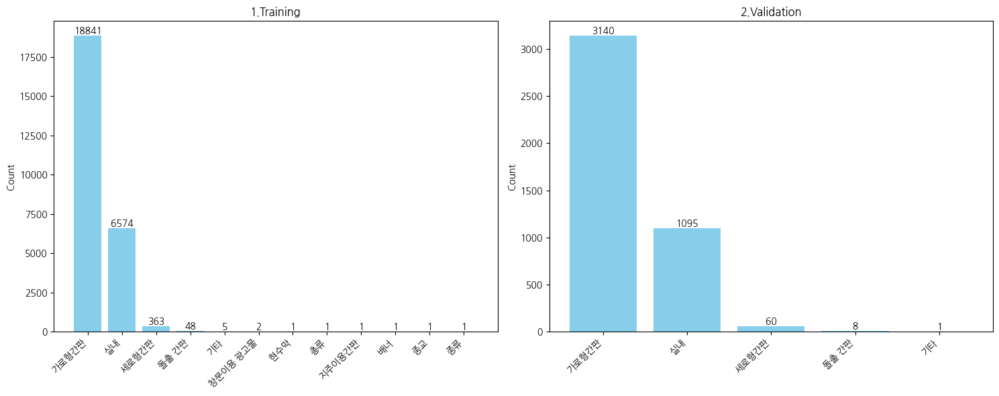

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# 한글 폰트 설정
plt.rc('font', family='NanumGothic')
plt.rc('axes', unicode_minus=False)

# 데이터 준비
# Training 데이터
train_labels = ['가로형간판', '실내', '세로형간판', '돌출 간판', 
                '기타', '창문이용 광고물', '현수막', '총류', '지주이용간판', '배너',
                '종교', '종류']  # 책표지 카테고리 추가
train_values = [18841, 6574, 363, 48, 5, 2, 1, 1, 1, 1,
                1, 1]  # 해당 값 추가

# Validation 데이터
val_labels = ['가로형간판', '실내', '세로형간판', '돌출 간판', '기타']
val_values = [3140, 1095, 60, 8, 1]

# 그래프 생성
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Training 데이터 플롯
bars1 = ax1.bar(range(len(train_values)), train_values, color='skyblue')
ax1.set_xticks(range(len(train_labels)))
ax1.set_xticklabels(train_labels, rotation=45, ha='right')
ax1.set_title('1.Training')
ax1.set_ylabel('Count')

# Validation 데이터 플롯
bars2 = ax2.bar(range(len(val_values)), val_values, color='skyblue')
ax2.set_xticks(range(len(val_labels)))
ax2.set_xticklabels(val_labels, rotation=45, ha='right')
ax2.set_title('2.Validation')
ax2.set_ylabel('Count')

# 막대 위에 값 표시
def add_value_labels(ax, bars):
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{int(height)}',
                ha='center', va='bottom')

add_value_labels(ax1, bars1)
add_value_labels(ax2, bars2)

plt.tight_layout()
plt.show()

## 이미지 파일크기 

이미지 크기 분석 중...


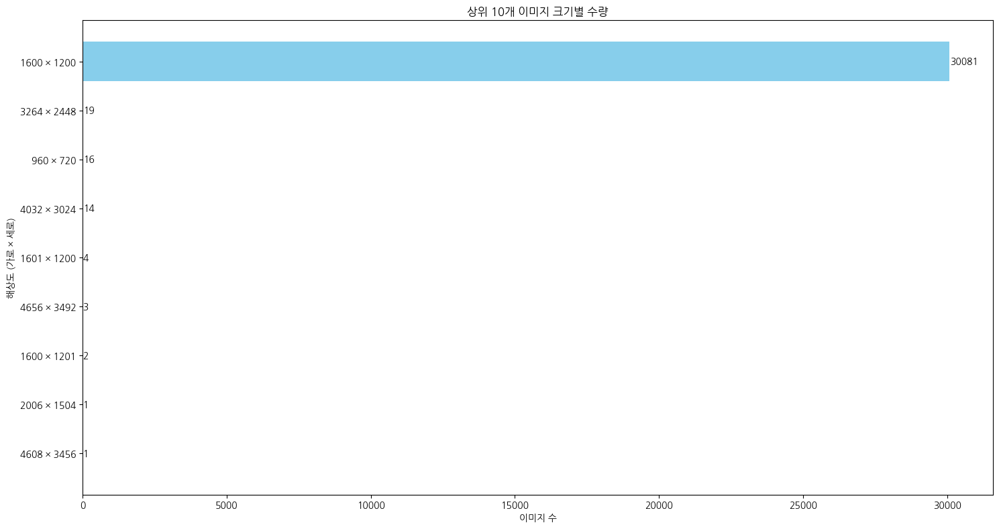


상위 10개 이미지 크기 분포:


,순위,해상도 (가로 × 세로),이미지 수
0,1,1600 × 1200,30081
1,2,3264 × 2448,19
2,3,960 × 720,16
3,4,4032 × 3024,14
4,5,1601 × 1200,4
5,6,4656 × 3492,3
6,7,1600 × 1201,2
7,8,2006 × 1504,1
8,9,4608 × 3456,1


In [14]:
# 이미지 파일 경로 수집
import os
from glob import glob

# 이미지 파일 경로 설정 
data_dir = '/data/ephemeral/home/data'
image_paths = []

# 이미지 확장자 리스트
img_extensions = ['.jpg', '.jpeg', '.png']

# 재귀적으로 모든 이미지 파일 찾기
for ext in img_extensions:
    image_paths.extend(glob(os.path.join(data_dir, '**', f'*{ext}'), recursive=True))

# 모든 이미지 크기 분석
image_sizes = []
print("이미지 크기 분석 중...")

for img_path in image_paths:
    try:
        with Image.open(img_path) as img:
            width, height = img.size
            image_sizes.append((width, height))
    except Exception as e:
        print(f"오류 발생: {img_path}, {e}")

# 이미지 크기별 카운트
resolution_counts = {}
for width, height in image_sizes:
    resolution = f"{width} × {height}"
    if resolution in resolution_counts:
        resolution_counts[resolution] += 1
    else:
        resolution_counts[resolution] = 1

# 빈도순으로 정렬하여 상위 10개 추출
top_resolutions = sorted(resolution_counts.items(), key=lambda x: x[1], reverse=True)[:10]

# 데이터프레임 생성
df_resolutions = pd.DataFrame(top_resolutions, columns=['해상도', '이미지 수'])
df_resolutions[['가로', '세로']] = df_resolutions['해상도'].str.split(' × ', expand=True)
df_resolutions['가로'] = df_resolutions['가로'].astype(int)
df_resolutions['세로'] = df_resolutions['세로'].astype(int)
df_resolutions['순위'] = range(1, len(df_resolutions) + 1)

# 막대 그래프 그리기
plt.figure(figsize=(15, 8))
plt.barh(df_resolutions['해상도'], df_resolutions['이미지 수'], color='skyblue')
plt.xlabel('이미지 수')
plt.ylabel('해상도 (가로 × 세로)')
plt.title('상위 10개 이미지 크기별 수량')
plt.gca().invert_yaxis()  # 빈도가 높은 순으로 위에서 아래로 정렬
for i, v in enumerate(df_resolutions['이미지 수']):
    plt.text(v + 10, i, str(v), va='center')
plt.tight_layout()
plt.show()

# 표 출력
display_df = df_resolutions[['순위', '가로', '세로', '이미지 수']].copy()
display_df['해상도 (가로 × 세로)'] = df_resolutions['해상도']
display_df = display_df[['순위', '해상도 (가로 × 세로)', '이미지 수']]
print("\n상위 10개 이미지 크기 분포:")
display(display_df)

# 텍스트 데이터 분석

In [15]:
# ## 5. 텍스트 데이터 분석 (OCR 특화)

# %% [코드 셀: 텍스트 데이터 수집]
def collect_text_data(label_paths, limit=100):
    """라벨 파일에서 텍스트 데이터를 수집합니다."""
    all_texts = []
    bbox_counts = []
    
    for path in label_paths[:limit]:
        try:
            if path.endswith('.json'):
                with open(path, 'r', encoding='utf-8') as f:
                    data = json.load(f)
                
                # 데이터 구조에 맞게 수정 필요
                if 'annotations' in data:
                    bbox_count = 0
                    for ann in data['annotations']:
                        if 'text' in ann and 'bbox' in ann:
                            text = ann['text']
                            all_texts.append(text)
                            bbox_count += 1
                    
                    if bbox_count > 0:
                        bbox_counts.append(bbox_count)
        
        except Exception as e:
            print(f"파일 분석 오류: {path}, {e}")
    
    return all_texts, bbox_counts

# 텍스트 데이터 수집
texts, bbox_counts = collect_text_data(label_paths, limit=200)
print(f"수집된 텍스트 개수: {len(texts)}")
print(f"분석한 이미지 개수: {len(bbox_counts)}")

# %% [코드 셀: 텍스트 길이 분석]
# 텍스트 길이 분석
text_lengths = [len(text) for text in texts]

plt.figure(figsize=(10, 6))
plt.hist(text_lengths, bins=20, color='skyblue', edgecolor='black')
plt.title('텍스트 길이 분포')
plt.xlabel('텍스트 길이 (문자 수)')
plt.ylabel('빈도')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

print(f"평균 텍스트 길이: {np.mean(text_lengths):.2f} 문자")
print(f"최대 텍스트 길이: {max(text_lengths)} 문자")
print(f"최소 텍스트 길이: {min(text_lengths)} 문자")

# %% [코드 셀: 바운딩 박스 개수 분석]
# 이미지 당 바운딩 박스 개수 분석
plt.figure(figsize=(10, 6))
plt.hist(bbox_counts, bins=range(1, max(bbox_counts) + 2), color='salmon', edgecolor='black')
plt.title('이미지 당 바운딩 박스 개수 분포')
plt.xlabel('바운딩 박스 개수')
plt.ylabel('이미지 수')
plt.xticks(range(1, max(bbox_counts) + 1))
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

print(f"이미지 당 평균 바운딩 박스 개수: {np.mean(bbox_counts):.2f}")
print(f"이미지 당 최대 바운딩 박스 개수: {max(bbox_counts)}")
print(f"이미지 당 최소 바운딩 박스 개수: {min(bbox_counts)}")

# %% [코드 셀: 문자 유형 분석]
def analyze_character_types(texts):
    """텍스트에서 한글, 영어, 숫자, 특수문자 비율 분석"""
    korean_chars = 0
    english_chars = 0
    number_chars = 0
    special_chars = 0
    total_chars = 0
    
    korean_pattern = re.compile('[가-힣]')
    english_pattern = re.compile('[a-zA-Z]')
    number_pattern = re.compile('[0-9]')
    
    for text in texts:
        for char in text:
            total_chars += 1
            if korean_pattern.match(char):
                korean_chars += 1
            elif english_pattern.match(char):
                english_chars += 1
            elif number_pattern.match(char):
                number_chars += 1
            else:
                special_chars += 1
    
    return {
        '한글': korean_chars / total_chars * 100 if total_chars > 0 else 0,
        '영어': english_chars / total_chars * 100 if total_chars > 0 else 0,
        '숫자': number_chars / total_chars * 100 if total_chars > 0 else 0,
        '특수문자': special_chars / total_chars * 100 if total_chars > 0 else 0
    }

# 문자 유형 분석
char_types = analyze_character_types(texts)

plt.figure(figsize=(10, 6))
plt.bar(char_types.keys(), char_types.values(), color=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99'])
plt.title('문자 유형 분포')
plt.xlabel('문자 유형')
plt.ylabel('비율 (%)')
for i, (key, value) in enumerate(char_types.items()):
    plt.text(i, value + 1, f"{value:.1f}%", ha='center')
plt.show()

# %% [코드 셀: 자주 등장하는 문자 분석]
def analyze_frequent_chars(texts, top_n=20):
    """가장 자주 등장하는 문자 분석"""
    all_chars = ''.join(texts)
    char_counter = Counter(all_chars)
    return char_counter.most_common(top_n)

# 자주 등장하는 문자 Top 20
top_chars = analyze_frequent_chars(texts)
chars, counts = zip(*top_chars)

plt.figure(figsize=(15, 6))
plt.bar(chars, counts, color='skyblue')
plt.title('가장 자주 등장하는 문자 Top 20')
plt.xlabel('문자')
plt.ylabel('등장 횟수')
plt.xticks(rotation=0, fontsize=12)
plt.tight_layout()
plt.show()



NameError: name 'label_paths' is not defined


=== 특수문자가 포함된 항목: 1개 ===


,file_path,file_name,item_index,text,bbox,special_chars
0,/data/ephemeral/home/data/TL1/1.간판/실내간판/간판_실내간...,간판_실내간판_003976.json,0,"바구니,부채","[332, 166, 528, 181]",","


총 1개 항목 중 10개만 표시됨


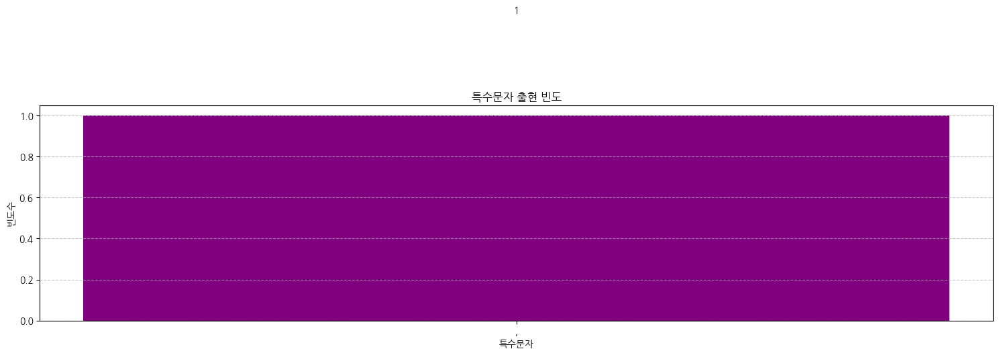


=== 특수문자가 포함된 샘플 시각화 ===


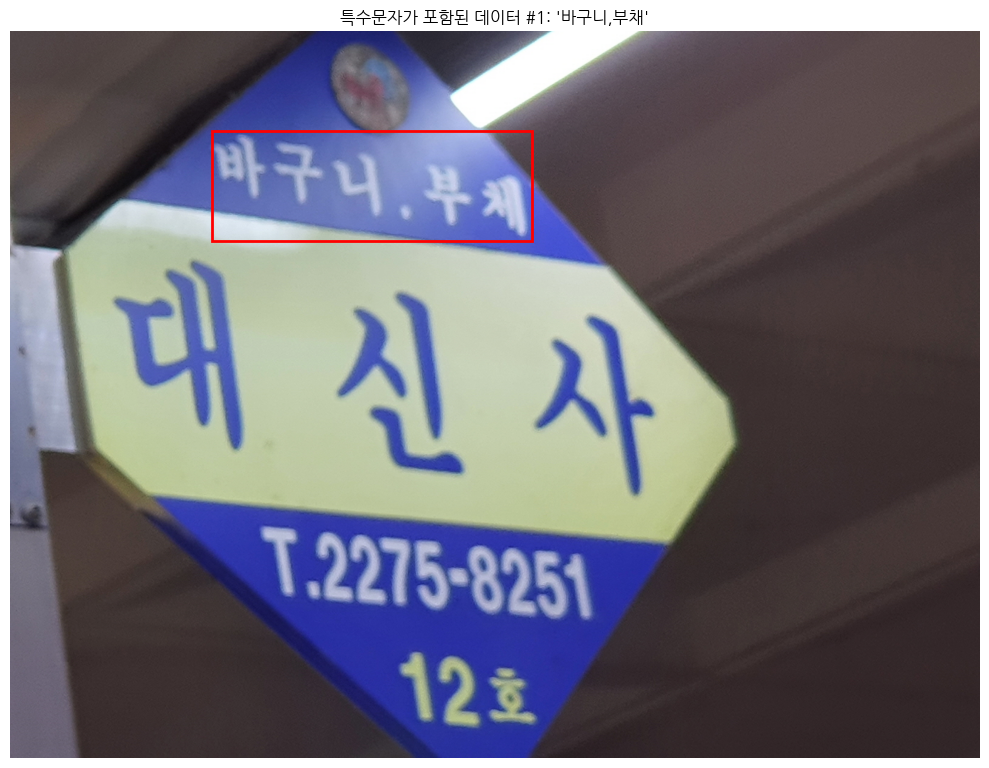

파일: 간판_실내간판_003976.json
텍스트: 바구니,부채
특수문자: ,
---


In [17]:
# 특수문자가 포함된 데이터 확인
import re
import string
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from collections import Counter

def check_special_chars_data():
    """데이터셋에서 특수문자가 포함된 항목들을 확인합니다."""
    # JSON 파일 목록 (이미 위에서 수집되었다고 가정)
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    # 결과를 저장할 리스트
    special_char_items = []
    
    # 특수문자 정의 (한글, 영문, 숫자, 공백을 제외한 문자)
    special_chars = set(string.punctuation)
    
    # 각 JSON 파일 분석
    for json_path in json_files:
        try:
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            # 파일 정보
            file_info = {
                'file_path': json_path,
                'file_name': os.path.basename(json_path)
            }
            
            # COCO 형식 확인
            if 'annotations' in data:
                for i, ann in enumerate(data['annotations']):
                    if 'text' in ann and isinstance(ann['text'], str):
                        text = ann['text']
                        special_chars_found = [char for char in text if char in special_chars]
                        
                        if special_chars_found:
                            item_info = {
                                **file_info,
                                'item_index': i,
                                'text': text,
                                'bbox': ann.get('bbox'),
                                'special_chars': ''.join(special_chars_found)
                            }
                            special_char_items.append(item_info)
            
            # LabelMe 형식 확인
            elif 'shapes' in data:
                for i, shape in enumerate(data['shapes']):
                    if 'label' in shape and isinstance(shape['label'], str):
                        label = shape['label']
                        special_chars_found = [char for char in label if char in special_chars]
                        
                        if special_chars_found:
                            item_info = {
                                **file_info,
                                'item_index': i,
                                'text': label,
                                'bbox': shape.get('points'),
                                'special_chars': ''.join(special_chars_found)
                            }
                            special_char_items.append(item_info)
                
        except Exception as e:
            print(f"파일 분석 오류: {json_path}, {e}")
    
    # 결과 출력
    print(f"\n=== 특수문자가 포함된 항목: {len(special_char_items)}개 ===")
    if special_char_items:
        special_char_df = pd.DataFrame(special_char_items)
        display(special_char_df.head(10))
        print(f"총 {len(special_char_items)}개 항목 중 10개만 표시됨")
    
    # 특수문자 빈도 분석
    all_special_chars = ''
    for item in special_char_items:
        all_special_chars += item['special_chars']
    
    char_counts = Counter(all_special_chars)
    
    # 특수문자 빈도 시각화
    if char_counts:
        plt.figure(figsize=(15, 6))
        chars = list(char_counts.keys())
        counts = list(char_counts.values())
        
        # 빈도수 기준 정렬
        sorted_indices = np.argsort(counts)[::-1]
        chars = [chars[i] for i in sorted_indices]
        counts = [counts[i] for i in sorted_indices]
        
        plt.bar(chars, counts, color='purple')
        plt.title('특수문자 출현 빈도')
        plt.xlabel('특수문자')
        plt.ylabel('빈도수')
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # 값 표시
        for i, v in enumerate(counts):
            plt.text(i, v + 0.5, str(v), ha='center')
            
        plt.tight_layout()
        plt.show()
    
    # 샘플 시각화
    def visualize_special_char_samples(count=5):
        if not special_char_items:
            return
        
        samples = special_char_items[:min(count, len(special_char_items))]
        
        for i, sample in enumerate(samples):
            json_path = sample['file_path']
            img_base = os.path.splitext(os.path.basename(json_path))[0]
            img_dir = os.path.dirname(json_path)
            
            # 이미지 파일 찾기
            for ext in ['.jpg', '.jpeg', '.png']:
                img_path = os.path.join(img_dir, img_base + ext)
                if os.path.exists(img_path):
                    break
            else:
                # 다른 위치에서 이미지 검색
                found = False
                for root, _, files in os.walk(data_path):
                    for file in files:
                        if file.startswith(img_base) and file.endswith(('.jpg', '.jpeg', '.png')):
                            img_path = os.path.join(root, file)
                            found = True
                            break
                    if found:
                        break
                if not found:
                    print(f"이미지를 찾을 수 없음: {img_base}")
                    continue
            
            try:
                # 이미지 로드 및 시각화
                image = Image.open(img_path)
                
                fig, ax = plt.subplots(figsize=(10, 8))
                ax.imshow(np.array(image))
                
                # 바운딩 박스 표시
                bbox = sample.get('bbox')
                if bbox and bbox != 'unknown':
                    if isinstance(bbox, list) and len(bbox) == 4:  # [x, y, w, h] 형식
                        x, y, w, h = bbox
                        rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                        ax.add_patch(rect)
                    elif isinstance(bbox, list) and len(bbox) == 2:  # [[x1, y1], [x2, y2]] 형식
                        x1, y1 = bbox[0]
                        x2, y2 = bbox[1]
                        rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=2, edgecolor='r', facecolor='none')
                        ax.add_patch(rect)
                
                ax.set_title(f"특수문자가 포함된 데이터 #{i+1}: '{sample['text']}'")
                ax.axis('off')
                plt.tight_layout()
                plt.show()
                
                # 정보 출력
                print(f"파일: {os.path.basename(json_path)}")
                print(f"텍스트: {sample['text']}")
                print(f"특수문자: {sample['special_chars']}")
                print("---")
                
            except Exception as e:
                print(f"시각화 오류: {img_path}, {e}")
    
    # 샘플 시각화
    if special_char_items:
        print("\n=== 특수문자가 포함된 샘플 시각화 ===")
        visualize_special_char_samples(5)

# 함수 실행
check_special_chars_data()

## 결측치 확인

발견된 JSON 파일: 30141개

=== 'null'이 포함된 텍스트: 0개 ===

=== 'x'가 포함된 텍스트: 58961개 ===


,file_path,text,bbox
0,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[540, 750, 636, 185]"
1,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[1347, 403, 253, 597]"
2,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[75, 392, 318, 638]"
3,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[967, 0, 570, 347]"
4,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[0, 685, 1599, 515]"
5,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[4, 3, 1596, 361]"
6,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[2, 3, 1598, 431]"
7,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[0, 397, 218, 803]"
8,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[201, 829, 1399, 371]"
9,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,xxx,"[613, 339, 734, 617]"


총 58961개 항목 중 10개만 표시됨

=== bbox가 없는 파일: 0개 ===

=== 'x'가 포함된 데이터 시각화 ===


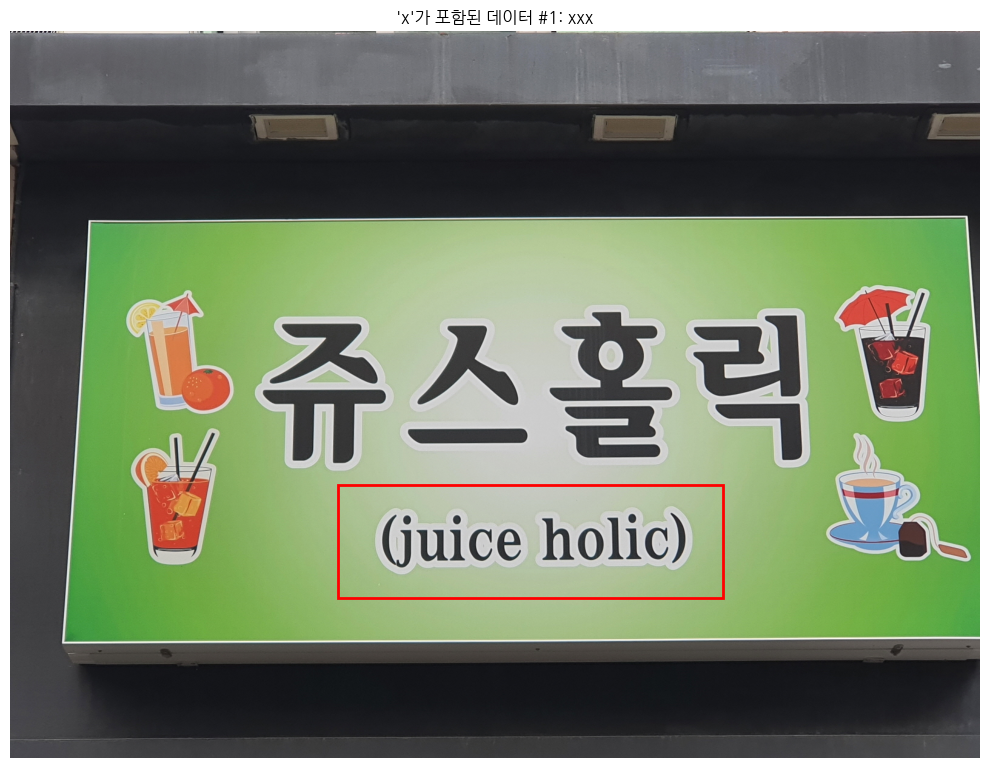

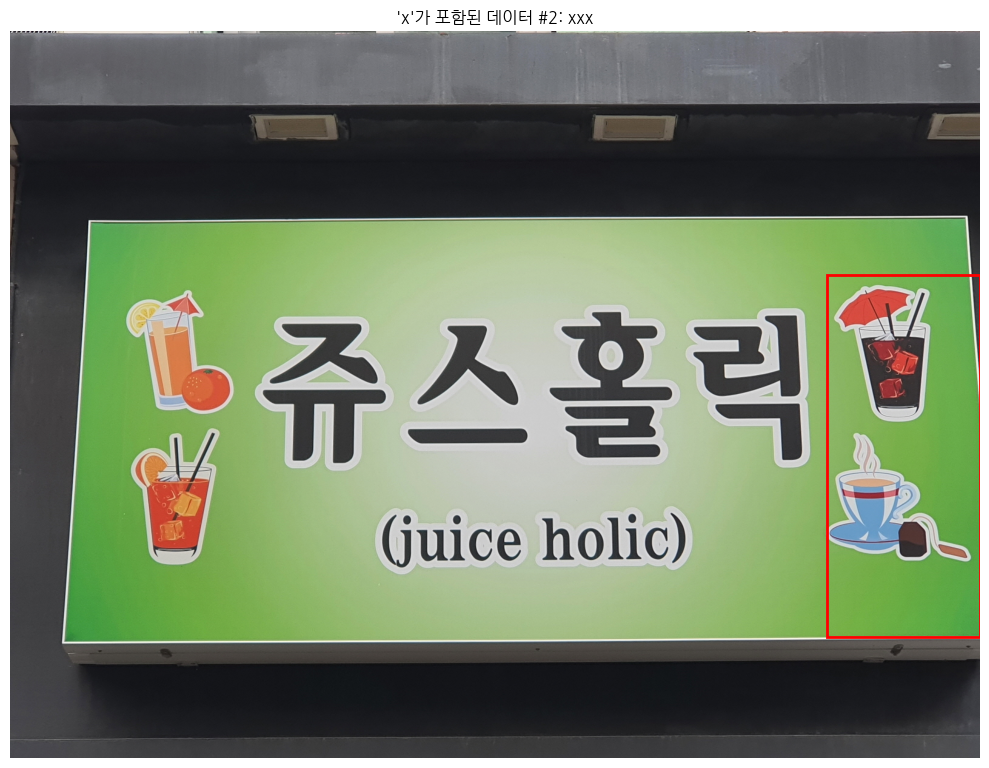

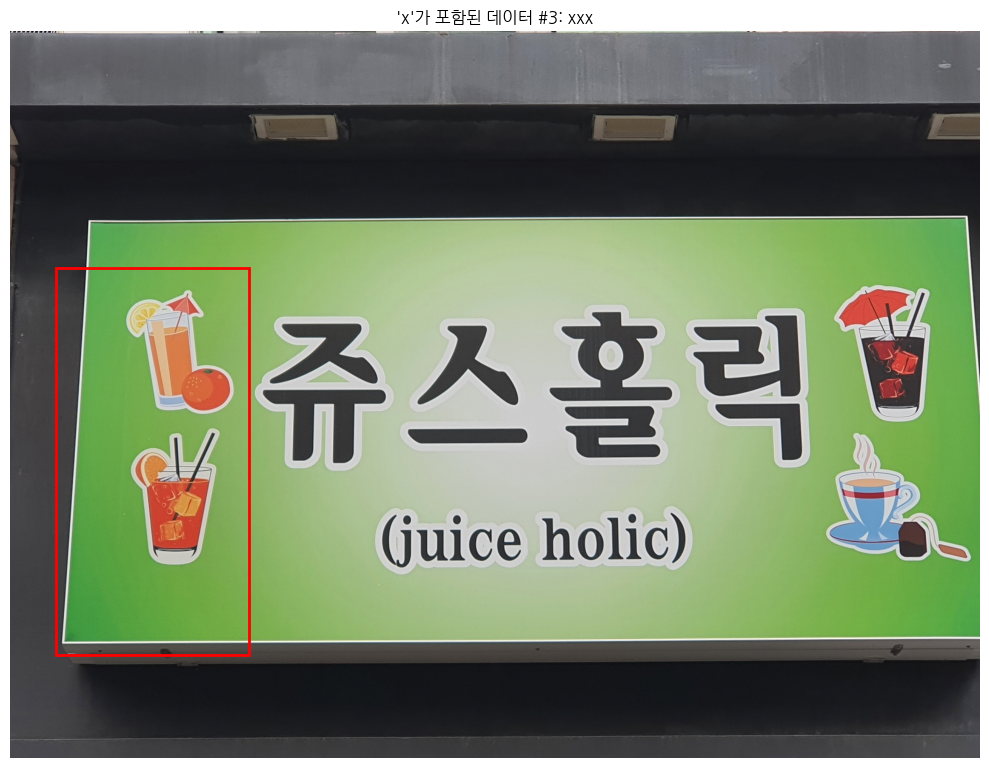

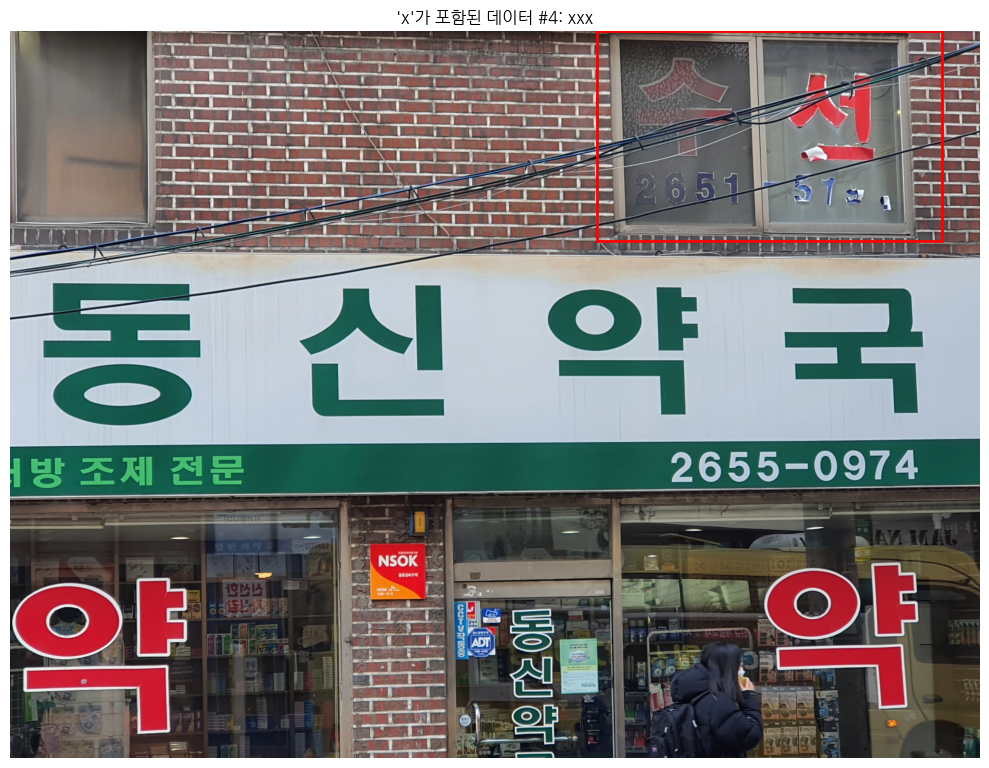

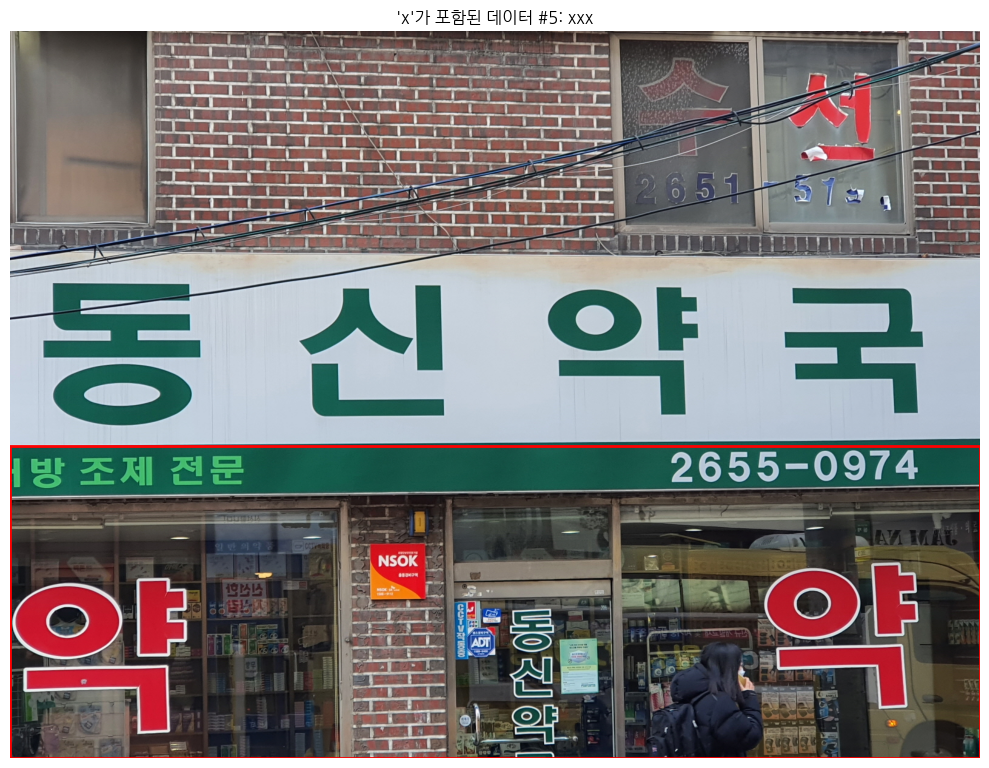

In [18]:
import os
import json
import pandas as pd
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import numpy as np

# 데이터 경로 (필요에 따라 수정)
data_path = "/data/ephemeral/home/data"
json_files = []

# JSON 파일 찾기
for root, _, files in os.walk(data_path):
    for file in files:
        if file.endswith('.json'):
            json_files.append(os.path.join(root, file))

print(f"발견된 JSON 파일: {len(json_files)}개")

# 필터링 결과를 저장할 리스트
null_texts = []      # 'null'이 포함된 텍스트
x_texts = []         # 'x'가 포함된 텍스트
no_bbox_files = []   # bbox가 없는 파일

# 데이터 필터링
for json_path in json_files:
    try:
        with open(json_path, 'r', encoding='utf-8') as f:
            data = json.load(f)
        
        # 파일 정보
        file_info = {
            'file_path': json_path,
            'file_name': os.path.basename(json_path)
        }
        
        # bbox 확인
        has_bbox = False
        
        # JSON 구조에 따라 다르게 처리
        if 'annotations' in data:
            # COCO 형식 
            for ann in data['annotations']:
                if 'bbox' in ann:
                    has_bbox = True
                    
                    # 텍스트 필드 확인
                    if 'text' in ann:
                        text = str(ann['text']).lower()
                        # 각 키워드별로 분리하여 저장
                        if 'null' in text:
                            null_texts.append({
                                'file_path': json_path,
                                'text': ann['text'],
                                'bbox': ann.get('bbox', 'unknown')
                            })
                        if 'x' in text:
                            x_texts.append({
                                'file_path': json_path,
                                'text': ann['text'],
                                'bbox': ann.get('bbox', 'unknown')
                            })
        
        elif 'shapes' in data:
            # LabelMe 형식
            for shape in data['shapes']:
                if shape['shape_type'] == 'rectangle':
                    has_bbox = True
                    
                    # 텍스트 필드 확인
                    if 'label' in shape:
                        text = str(shape['label']).lower()
                        # 각 키워드별로 분리하여 저장
                        if 'null' in text:
                            null_texts.append({
                                'file_path': json_path,
                                'text': shape['label'],
                                'bbox': shape.get('points', 'unknown')
                            })
                        if 'x' in text:
                            x_texts.append({
                                'file_path': json_path,
                                'text': shape['label'],
                                'bbox': shape.get('points', 'unknown')
                            })
        
        # bbox가 없는 파일 확인
        if not has_bbox:
            no_bbox_files.append(file_info)
        
    except Exception as e:
        print(f"파일 분석 오류: {json_path}, {e}")

# 결과 출력
print(f"\n=== 'null'이 포함된 텍스트: {len(null_texts)}개 ===")
if null_texts:
    null_df = pd.DataFrame(null_texts)
    display(null_df.head(10))  # 상위 10개만 표시
    print(f"총 {len(null_texts)}개 항목 중 10개만 표시됨")

print(f"\n=== 'x'가 포함된 텍스트: {len(x_texts)}개 ===")
if x_texts:
    x_df = pd.DataFrame(x_texts)
    display(x_df.head(10))  # 상위 10개만 표시
    print(f"총 {len(x_texts)}개 항목 중 10개만 표시됨")

print(f"\n=== bbox가 없는 파일: {len(no_bbox_files)}개 ===")
if no_bbox_files:
    no_bbox_df = pd.DataFrame(no_bbox_files)
    display(no_bbox_df.head(10))  # 상위 10개만 표시
    print(f"총 {len(no_bbox_files)}개 파일 중 10개만 표시됨")

# 문제 데이터 시각화 함수
def visualize_problematic_data(data_list, sample_count=3, title="문제 데이터"):
    """문제가 있는 데이터 샘플 시각화"""
    if not data_list:
        print(f"시각화할 {title}가 없습니다.")
        return
    
    # 샘플 수 제한
    samples = data_list[:min(sample_count, len(data_list))]
    
    for i, sample in enumerate(samples):
        # 해당 이미지 파일 찾기
        json_path = sample['file_path']
        img_base = os.path.splitext(os.path.basename(json_path))[0]
        img_dir = os.path.dirname(json_path)
        
        # 가능한 이미지 확장자
        for ext in ['.jpg', '.jpeg', '.png']:
            img_path = os.path.join(img_dir, img_base + ext)
            if os.path.exists(img_path):
                break
        else:
            # 동일 디렉토리에서 찾지 못한 경우, 상위 디렉토리에서 검색
            found = False
            for root, _, files in os.walk(data_path):
                for file in files:
                    if file.startswith(img_base) and file.endswith(('.jpg', '.jpeg', '.png')):
                        img_path = os.path.join(root, file)
                        found = True
                        break
                if found:
                    break
            if not found:
                print(f"이미지를 찾을 수 없음: {img_base}")
                continue
        
        try:
            # 이미지 로드
            image = Image.open(img_path)
            
            # 이미지와 바운딩 박스 시각화
            fig, ax = plt.subplots(figsize=(10, 8))
            ax.imshow(np.array(image))
            
            # 바운딩 박스 표시
            bbox = sample.get('bbox')
            if bbox and bbox != 'unknown':
                if isinstance(bbox, list) and len(bbox) == 4:  # [x, y, w, h] 형식
                    x, y, w, h = bbox
                    rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                elif isinstance(bbox, list) and len(bbox) == 2:  # [[x1, y1], [x2, y2]] 형식
                    x1, y1 = bbox[0]
                    x2, y2 = bbox[1]
                    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
            
            # 텍스트 정보 표시
            ax.set_title(f"{title} #{i+1}: {sample.get('text', 'unknown')}")
            ax.axis('off')
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"이미지 시각화 오류: {img_path}, {e}")

# 각 문제 데이터 유형별 시각화 (최대 3개씩)
if null_texts:
    print("\n=== 'null'이 포함된 데이터 시각화 ===")
    visualize_problematic_data(null_texts, 3, "'null'이 포함된 데이터")

if x_texts:
    print("\n=== 'x'가 포함된 데이터 시각화 ===")
    visualize_problematic_data(x_texts, 5, "'x'가 포함된 데이터")  # 5개로 증가

In [23]:
# BBOX가 가장 많은 이미지 찾기
def find_image_with_most_boxes():
    """데이터셋에서 바운딩 박스가 가장 많은 이미지를 찾아 시각화합니다."""
    
    # JSON 파일 목록 가져오기
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
                
    max_boxes = 0
    max_boxes_file = None
    max_boxes_data = None
    
    # 각 JSON 파일 분석
    for json_path in json_files:
        try:
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
                
            if 'annotations' in data:
                num_boxes = len(data['annotations'])
                if num_boxes > max_boxes:
                    max_boxes = num_boxes
                    max_boxes_file = json_path
                    max_boxes_data = data
        except:
            continue
            
    if max_boxes_file:
        print(f"\n가장 많은 바운딩 박스를 가진 이미지:")
        print(f"파일: {max_boxes_file}")
        print(f"바운딩 박스 수: {max_boxes}")
        
        # 이미지 파일 경로 찾기
        img_path = max_boxes_file.replace('.json', '.jpg')
        if not os.path.exists(img_path):
            img_path = max_boxes_file.replace('.json', '.png')
            
        if os.path.exists(img_path):
            # 이미지와 바운딩 박스 시각화
            image = Image.open(img_path)
            fig, ax = plt.subplots(figsize=(15, 10))
            ax.imshow(np.array(image))
            
            # 각 바운딩 박스 표시
            for ann in max_boxes_data['annotations']:
                bbox = ann.get('bbox')
                if bbox and isinstance(bbox, list) and len(bbox) == 4:
                    x, y, w, h = bbox
                    rect = plt.Rectangle((x, y), w, h, linewidth=1, 
                                      edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    # 텍스트 표시
                    text = ann.get('text', '')
                    ax.text(x, y-5, text, color='red', fontsize=8)
            
            ax.set_title(f"바운딩 박스가 가장 많은 이미지 ({max_boxes}개)")
            ax.axis('off')
            plt.tight_layout()
            plt.show()
        else:
            print("이미지 파일을 찾을 수 없습니다.")
            
# 함수 실행
find_image_with_most_boxes()



가장 많은 바운딩 박스를 가진 이미지:
파일: /data/ephemeral/home/data/TL1/1.간판/실내간판/간판_실내간판_006086.json
바운딩 박스 수: 41
이미지 파일을 찾을 수 없습니다.


총 30141개의 JSON 파일을 분석합니다...

=== 중복된 텍스트 라벨이 있는 항목: 16532개 ===


,file_path,file_name,text,count,indices
0,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019252.json,xxx,3,"[2, 3, 4]"
1,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019945.json,xxx,2,"[1, 2]"
2,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_018949.json,xxx,3,"[3, 4, 5]"
3,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019870.json,xxx,2,"[2, 3]"
4,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_021842.json,xxx,2,"[2, 3]"
5,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_018916.json,xxx,5,"[2, 3, 4, 5, 6]"
6,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_020306.json,xxx,3,"[1, 2, 3]"
7,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_021823.json,xxx,4,"[2, 3, 4, 5]"
8,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019715.json,xxx,2,"[1, 2]"
9,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_020085.json,xxx,3,"[1, 2, 3]"


총 16532개 항목 중 10개만 표시됨

=== 겹치는 바운딩 박스가 있는 항목: 6개 ===


,file_path,file_name,bbox1,bbox2,text1,text2,iou
0,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_005491.json,"[0, 757, 1600, 443]","[0, 744, 1600, 456]",xxx,xxx,0.971491
1,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_012023.json,"[0, 0, 1300, 627]","[0, 0, 1600, 631]",xxx,xxx,0.807349
2,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_007895.json,"[798, 540, 692, 573]","[718, 507, 765, 543]",xxx,xxx,0.755252
3,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_008597.json,"[728, 1009, 156, 191]","[736, 1029, 161, 171]",xxx,xxx,0.790406
4,/data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...,간판_돌출간판_000016.json,"[724, 789, 150, 39]","[724, 789, 150, 39]",xxx,xxx,1.000000
5,/data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...,간판_돌출간판_000016.json,"[280, 0, 299, 992]","[280, 0, 299, 992]",xxx,xxx,1.000000


총 6개 항목 중 10개만 표시됨

=== 빈 텍스트 또는 짧은 텍스트가 있는 항목: 0개 ===

=== 잘못된 형식의 라벨이 있는 항목: 0개 ===

=== 중복된 텍스트 라벨이 있는 샘플 시각화 ===


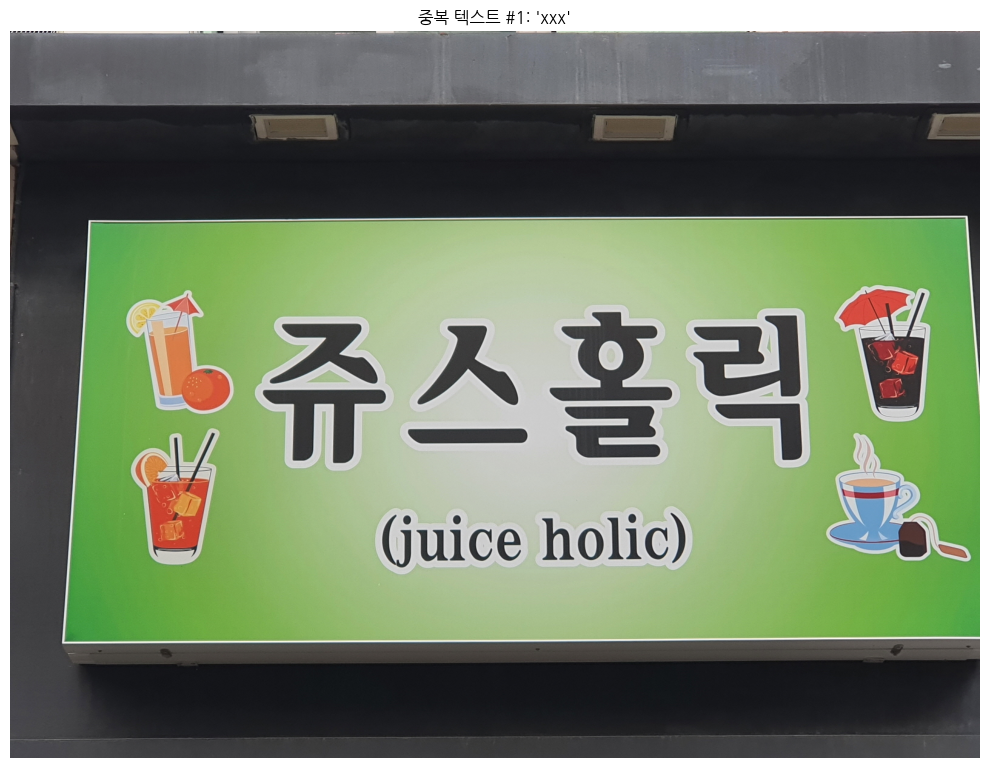

파일: 간판_가로형간판_019252.json
중복 횟수: 3
---


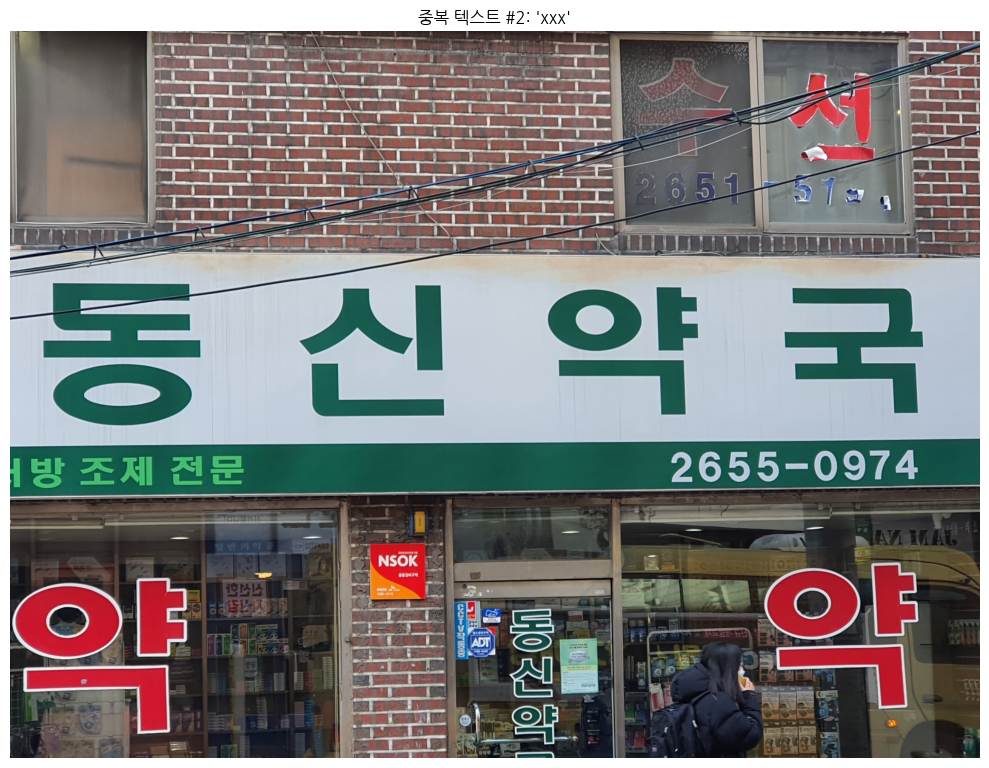

파일: 간판_가로형간판_019945.json
중복 횟수: 2
---


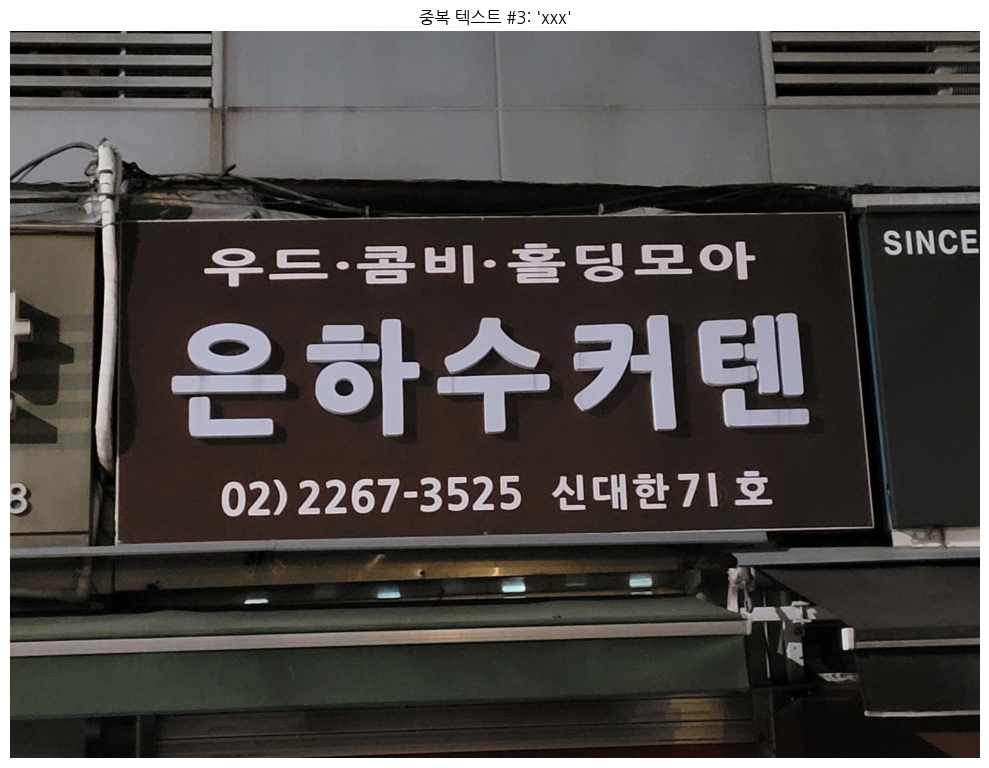

파일: 간판_가로형간판_018949.json
중복 횟수: 3
---

=== 겹치는 바운딩 박스가 있는 샘플 시각화 ===


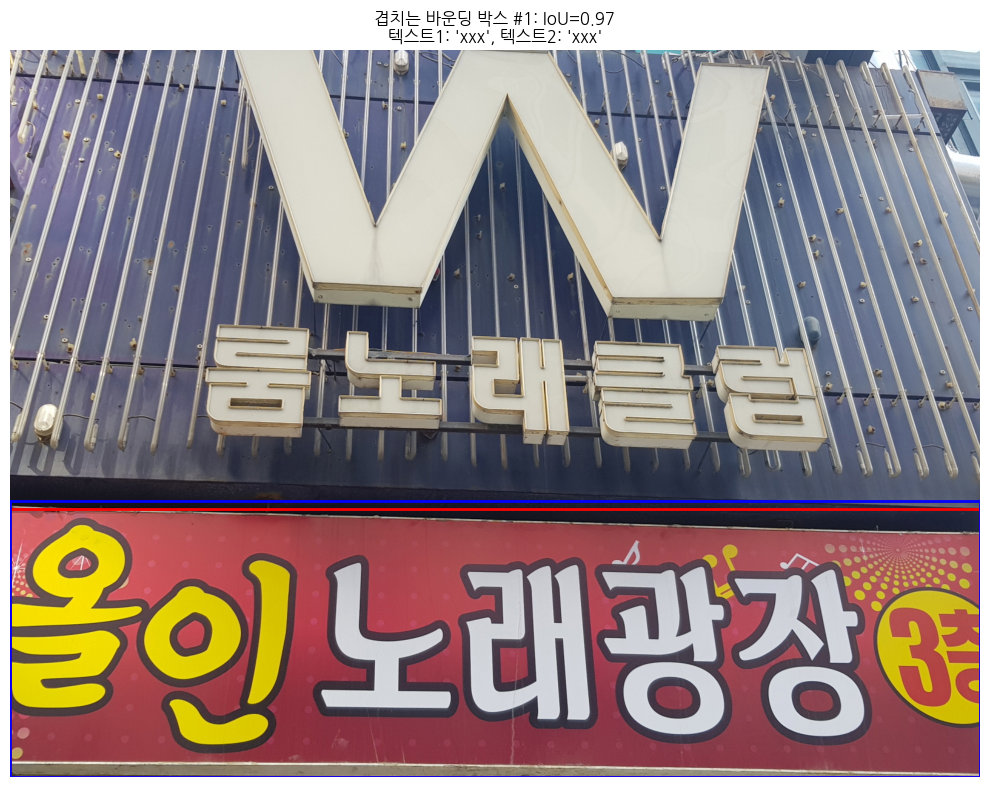

파일: 간판_가로형간판_005491.json
---


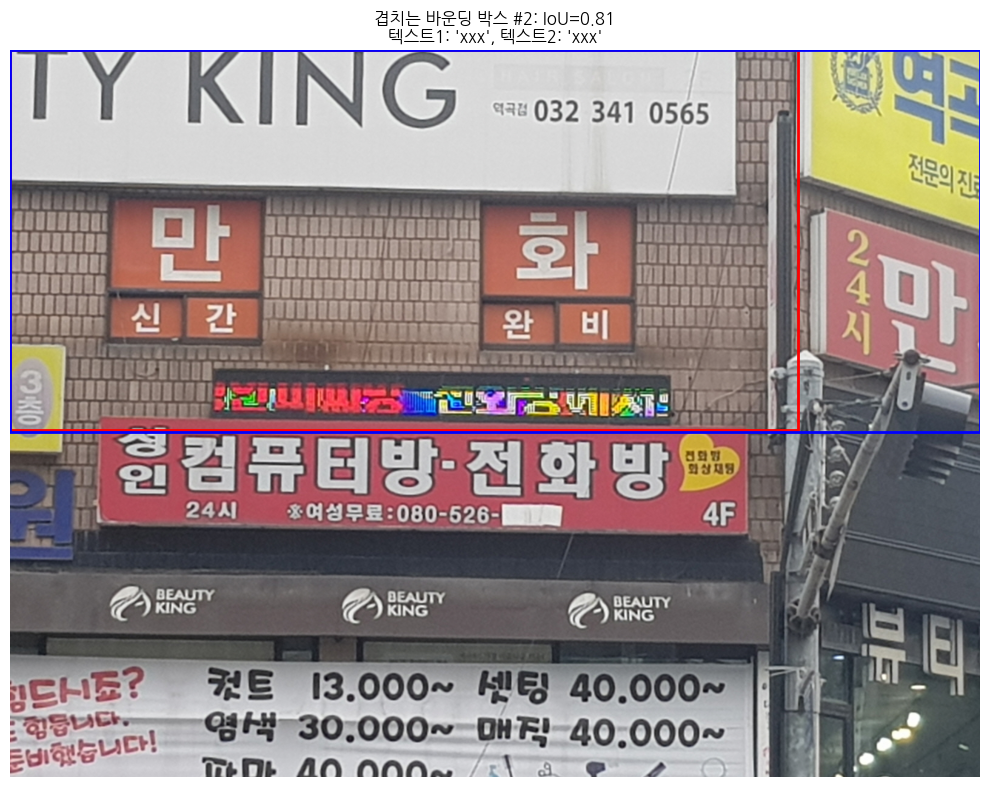

파일: 간판_가로형간판_012023.json
---


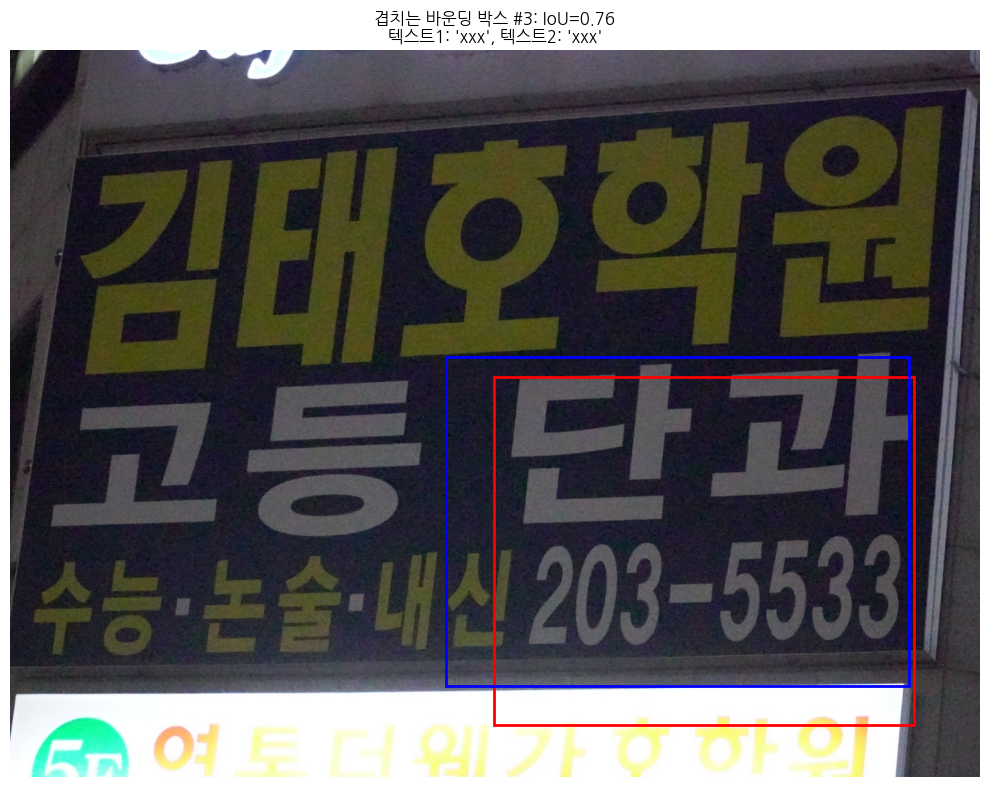

파일: 간판_가로형간판_007895.json
---


In [51]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from collections import defaultdict
from shapely.geometry import box

def check_duplicate_labels():
    """데이터셋에서 중복되거나 불필요한 라벨이 있는 이미지를 확인합니다."""
    # JSON 파일 목록
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    print(f"총 {len(json_files)}개의 JSON 파일을 분석합니다...")
    
    # 결과를 저장할 리스트
    duplicate_text_items = []      # 동일한 텍스트가 중복된 경우
    overlapping_bbox_items = []    # 바운딩 박스가 상당히 겹치는 경우
    empty_text_items = []          # 빈 텍스트 또는 너무 짧은 텍스트
    invalid_label_items = []       # 잘못된 형식의 라벨
    
    # 임계값 설정
    iou_threshold = 0.7           # IoU(Intersection over Union) 임계값
    min_text_length = 1           # 최소 텍스트 길이
    
    # 각 JSON 파일 분석
    for json_path in json_files:
        try:
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            # 파일 정보
            file_info = {
                'file_path': json_path,
                'file_name': os.path.basename(json_path)
            }
            
            # COCO 형식 확인
            if 'annotations' in data:
                annotations = data['annotations']
                
                # 텍스트 중복 확인
                text_counts = defaultdict(list)
                for i, ann in enumerate(annotations):
                    if 'text' in ann and isinstance(ann['text'], str):
                        text = ann['text'].strip()
                        if text:  # 빈 문자열이 아닌 경우만
                            text_counts[text].append(i)
                
                # 중복 텍스트 찾기
                for text, indices in text_counts.items():
                    if len(indices) > 1:
                        item_info = {
                            **file_info,
                            'text': text,
                            'count': len(indices),
                            'indices': indices
                        }
                        duplicate_text_items.append(item_info)
                
                # 바운딩 박스 겹침 확인
                for i, ann1 in enumerate(annotations):
                    if 'bbox' not in ann1 or not isinstance(ann1['bbox'], list) or len(ann1['bbox']) != 4:
                        continue
                    
                    x1, y1, w1, h1 = ann1['bbox']
                    box1 = box(x1, y1, x1 + w1, y1 + h1)
                    
                    for j, ann2 in enumerate(annotations):
                        if i >= j:  # 중복 비교 방지
                            continue
                        
                        if 'bbox' not in ann2 or not isinstance(ann2['bbox'], list) or len(ann2['bbox']) != 4:
                            continue
                        
                        x2, y2, w2, h2 = ann2['bbox']
                        box2 = box(x2, y2, x2 + w2, y2 + h2)
                        
                        # IoU 계산
                        if box1.intersects(box2):
                            intersection_area = box1.intersection(box2).area
                            union_area = box1.area + box2.area - intersection_area
                            iou = intersection_area / union_area if union_area > 0 else 0
                            
                            if iou > iou_threshold:
                                item_info = {
                                    **file_info,
                                    'bbox1': ann1['bbox'],
                                    'bbox2': ann2['bbox'],
                                    'text1': ann1.get('text', ''),
                                    'text2': ann2.get('text', ''),
                                    'iou': iou
                                }
                                overlapping_bbox_items.append(item_info)
                
                # 빈 텍스트 또는 짧은 텍스트 확인
                for i, ann in enumerate(annotations):
                    if 'text' in ann:
                        text = str(ann['text']).strip()
                        if len(text) < min_text_length:
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': text,
                                'bbox': ann.get('bbox', [])
                            }
                            empty_text_items.append(item_info)
                
                # 잘못된 형식의 라벨 확인 (예: 숫자만 있거나 특수문자만 있는 경우)
                for i, ann in enumerate(annotations):
                    if 'text' in ann and isinstance(ann['text'], str):
                        text = ann['text'].strip()
                        # 숫자만 있는 경우, 또는 특수문자만 있는 경우 등 조건 추가 가능
                        if text.isdigit() and len(text) > 5:  # 긴 숫자 시퀀스만 있는 경우
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': text,
                                'reason': '숫자만 있는 긴 텍스트',
                                'bbox': ann.get('bbox', [])
                            }
                            invalid_label_items.append(item_info)
            
            # LabelMe 형식 확인
            elif 'shapes' in data:
                shapes = data['shapes']
                
                # 텍스트 중복 확인
                label_counts = defaultdict(list)
                for i, shape in enumerate(shapes):
                    if 'label' in shape and isinstance(shape['label'], str):
                        label = shape['label'].strip()
                        if label:  # 빈 문자열이 아닌 경우만
                            label_counts[label].append(i)
                
                # 중복 라벨 찾기
                for label, indices in label_counts.items():
                    if len(indices) > 1:
                        item_info = {
                            **file_info,
                            'text': label,
                            'count': len(indices),
                            'indices': indices
                        }
                        duplicate_text_items.append(item_info)
                
                # 바운딩 박스 겹침 확인
                for i, shape1 in enumerate(shapes):
                    if shape1['shape_type'] != 'rectangle' or 'points' not in shape1:
                        continue
                    
                    points1 = shape1['points']
                    if len(points1) != 2:
                        continue
                    
                    x1, y1 = points1[0]
                    x2, y2 = points1[1]
                    box1 = box(min(x1, x2), min(y1, y2), max(x1, x2), max(y1, y2))
                    
                    for j, shape2 in enumerate(shapes):
                        if i >= j:  # 중복 비교 방지
                            continue
                        
                        if shape2['shape_type'] != 'rectangle' or 'points' not in shape2:
                            continue
                        
                        points2 = shape2['points']
                        if len(points2) != 2:
                            continue
                        
                        x3, y3 = points2[0]
                        x4, y4 = points2[1]
                        box2 = box(min(x3, x4), min(y3, y4), max(x3, x4), max(y3, y4))
                        
                        # IoU 계산
                        if box1.intersects(box2):
                            intersection_area = box1.intersection(box2).area
                            union_area = box1.area + box2.area - intersection_area
                            iou = intersection_area / union_area if union_area > 0 else 0
                            
                            if iou > iou_threshold:
                                item_info = {
                                    **file_info,
                                    'points1': points1,
                                    'points2': points2,
                                    'label1': shape1.get('label', ''),
                                    'label2': shape2.get('label', ''),
                                    'iou': iou
                                }
                                overlapping_bbox_items.append(item_info)
                
                # 빈 라벨 또는 짧은 텍스트 확인
                for i, shape in enumerate(shapes):
                    if 'label' in shape:
                        label = str(shape['label']).strip()
                        if len(label) < min_text_length:
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': label,
                                'points': shape.get('points', [])
                            }
                            empty_text_items.append(item_info)
                
                # 잘못된 형식의 라벨 확인
                for i, shape in enumerate(shapes):
                    if 'label' in shape and isinstance(shape['label'], str):
                        label = shape['label'].strip()
                        if label.isdigit() and len(label) > 5:  # 긴 숫자 시퀀스만 있는 경우
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': label,
                                'reason': '숫자만 있는 긴 텍스트',
                                'points': shape.get('points', [])
                            }
                            invalid_label_items.append(item_info)
                
        except Exception as e:
            print(f"파일 분석 오류: {json_path}, {e}")
    
    # 결과 출력
    print(f"\n=== 중복된 텍스트 라벨이 있는 항목: {len(duplicate_text_items)}개 ===")
    if duplicate_text_items:
        duplicate_df = pd.DataFrame(duplicate_text_items)
        display(duplicate_df.head(10))
        print(f"총 {len(duplicate_text_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 겹치는 바운딩 박스가 있는 항목: {len(overlapping_bbox_items)}개 ===")
    if overlapping_bbox_items:
        overlap_df = pd.DataFrame(overlapping_bbox_items)
        display(overlap_df.head(10))
        print(f"총 {len(overlapping_bbox_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 빈 텍스트 또는 짧은 텍스트가 있는 항목: {len(empty_text_items)}개 ===")
    if empty_text_items:
        empty_df = pd.DataFrame(empty_text_items)
        display(empty_df.head(10))
        print(f"총 {len(empty_text_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 잘못된 형식의 라벨이 있는 항목: {len(invalid_label_items)}개 ===")
    if invalid_label_items:
        invalid_df = pd.DataFrame(invalid_label_items)
        display(invalid_df.head(10))
        print(f"총 {len(invalid_label_items)}개 항목 중 10개만 표시됨")
    
    # 샘플 시각화 함수
    def visualize_problematic_samples(items, title, count=3):
        if not items:
            return
        
        samples = items[:min(count, len(items))]
        
        for i, sample in enumerate(samples):
            json_path = sample['file_path']
            img_base = os.path.splitext(os.path.basename(json_path))[0]
            img_dir = os.path.dirname(json_path)
            
            # 이미지 파일 찾기
            for ext in ['.jpg', '.jpeg', '.png']:
                img_path = os.path.join(img_dir, img_base + ext)
                if os.path.exists(img_path):
                    break
            else:
                # 다른 위치에서 이미지 검색
                found = False
                for root, _, files in os.walk(data_path):
                    for file in files:
                        if file.startswith(img_base) and file.endswith(('.jpg', '.jpeg', '.png')):
                            img_path = os.path.join(root, file)
                            found = True
                            break
                    if found:
                        break
                if not found:
                    print(f"이미지를 찾을 수 없음: {img_base}")
                    continue
            
            try:
                # 이미지 로드 및 시각화
                image = Image.open(img_path)
                
                fig, ax = plt.subplots(figsize=(10, 8))
                ax.imshow(np.array(image))
                
                # 바운딩 박스 표시 (샘플 종류에 따라 다르게 처리)
                if 'bbox1' in sample and 'bbox2' in sample:
                    # 겹치는 바운딩 박스의 경우
                    x1, y1, w1, h1 = sample['bbox1']
                    rect1 = plt.Rectangle((x1, y1), w1, h1, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect1)
                    
                    x2, y2, w2, h2 = sample['bbox2']
                    rect2 = plt.Rectangle((x2, y2), w2, h2, linewidth=2, edgecolor='b', facecolor='none')
                    ax.add_patch(rect2)
                    
                    title_text = f"{title} #{i+1}: IoU={sample['iou']:.2f}"
                    if 'text1' in sample and 'text2' in sample:
                        title_text += f"\n텍스트1: '{sample['text1']}', 텍스트2: '{sample['text2']}'"
                
                elif 'points1' in sample and 'points2' in sample:
                    # LabelMe 형식의 겹치는 바운딩 박스
                    x1, y1 = sample['points1'][0]
                    x2, y2 = sample['points1'][1]
                    rect1 = plt.Rectangle((min(x1, x2), min(y1, y2)), abs(x2-x1), abs(y2-y1), 
                                         linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect1)
                    
                    x3, y3 = sample['points2'][0]
                    x4, y4 = sample['points2'][1]
                    rect2 = plt.Rectangle((min(x3, x4), min(y3, y4)), abs(x4-x3), abs(y4-y3), 
                                         linewidth=2, edgecolor='b', facecolor='none')
                    ax.add_patch(rect2)
                    
                    title_text = f"{title} #{i+1}: IoU={sample['iou']:.2f}"
                    if 'label1' in sample and 'label2' in sample:
                        title_text += f"\n라벨1: '{sample['label1']}', 라벨2: '{sample['label2']}'"
                
                elif 'bbox' in sample and isinstance(sample['bbox'], list) and len(sample['bbox']) == 4:
                    # 일반적인 바운딩 박스
                    x, y, w, h = sample['bbox']
                    rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                elif 'points' in sample and isinstance(sample['points'], list) and len(sample['points']) == 2:
                    # LabelMe 형식의 바운딩 박스
                    x1, y1 = sample['points'][0]
                    x2, y2 = sample['points'][1]
                    rect = plt.Rectangle((min(x1, x2), min(y1, y2)), abs(x2-x1), abs(y2-y1), 
                                        linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                else:
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                ax.set_title(title_text)
                ax.axis('off')
                plt.tight_layout()
                plt.show()
                
                # 추가 정보 출력
                print(f"파일: {os.path.basename(json_path)}")
                if 'count' in sample:
                    print(f"중복 횟수: {sample['count']}")
                if 'reason' in sample:
                    print(f"문제 이유: {sample['reason']}")
                print("---")
                
            except Exception as e:
                print(f"시각화 오류: {img_path}, {e}")
    
    # 각 문제 유형별 샘플 시각화
    if duplicate_text_items:
        print("\n=== 중복된 텍스트 라벨이 있는 샘플 시각화 ===")
        visualize_problematic_samples(duplicate_text_items, "중복 텍스트", 3)
    
    if overlapping_bbox_items:
        print("\n=== 겹치는 바운딩 박스가 있는 샘플 시각화 ===")
        visualize_problematic_samples(overlapping_bbox_items, "겹치는 바운딩 박스", 3)
    
    if empty_text_items:
        print("\n=== 빈 텍스트 또는 짧은 텍스트가 있는 샘플 시각화 ===")
        visualize_problematic_samples(empty_text_items, "빈/짧은 텍스트", 3)
    
    if invalid_label_items:
        print("\n=== 잘못된 형식의 라벨이 있는 샘플 시각화 ===")
        visualize_problematic_samples(invalid_label_items, "잘못된 라벨 형식", 3)
    
    # 모든 문제 항목 반환
    return {
        'duplicate_texts': duplicate_text_items,
        'overlapping_bboxes': overlapping_bbox_items,
        'empty_texts': empty_text_items,
        'invalid_labels': invalid_label_items
    }

# 함수 실행
problematic_items = check_duplicate_labels()

In [64]:
# 'xxx' 텍스트가 포함된 파일 확인하기
import os
import json
from tqdm import tqdm

def count_files_with_xxx():
    """데이터셋에서 'xxx' 텍스트가 포함된 파일의 수를 계산합니다."""
    # JSON 파일 목록
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    print(f"총 {len(json_files)}개의 JSON 파일을 분석합니다...")
    
    # 'xxx'가 포함된 파일 카운트
    xxx_files = 0
    xxx_labels_count = 0
    
    # 각 JSON 파일 분석
    for json_path in tqdm(json_files):
        try:
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            has_xxx = False
            file_xxx_count = 0
            
            # 어노테이션 확인
            if 'annotations' in data:
                for anno in data['annotations']:
                    if 'text' in anno and anno['text'] == 'xxx':
                        has_xxx = True
                        file_xxx_count += 1
            
            # 다른 형식의 JSON 파일 처리
            elif 'text' in data:
                if isinstance(data['text'], list):
                    for text in data['text']:
                        if text == 'xxx':
                            has_xxx = True
                            file_xxx_count += 1
                elif data['text'] == 'xxx':
                    has_xxx = True
                    file_xxx_count += 1
            
            if has_xxx:
                xxx_files += 1
                xxx_labels_count += file_xxx_count
                
        except Exception as e:
            print(f"파일 분석 오류: {json_path}, {e}")
    
    print(f"\n'xxx' 텍스트가 포함된 파일 수: {xxx_files}")
    print(f"'xxx' 텍스트 라벨 총 개수: {xxx_labels_count}")
    
    return xxx_files, xxx_labels_count

# 함수 실행
xxx_files_count, xxx_labels_total = count_files_with_xxx()


총 30141개의 JSON 파일을 분석합니다...


100%|██████████| 30141/30141 [00:00<00:00, 34477.95it/s]


'xxx' 텍스트가 포함된 파일 수: 23300
'xxx' 텍스트 라벨 총 개수: 58937


총 30141개의 JSON 파일을 분석합니다...

=== 전체 텍스트 라벨 분석 ===

=== 가장 많이 중복된 텍스트 라벨 TOP 30 ===
'xxx': 58942회 출현
'부동산': 354회 출현
'공인중개사': 286회 출현
'노래방': 173회 출현
'의원': 170회 출현
'헤어': 166회 출현
'노래': 165회 출현
'한의원': 164회 출현
'치과': 144회 출현
'사무소': 139회 출현
'노래연습장': 132회 출현
'주': 130회 출현
'약국': 118회 출현
'호': 112회 출현
'학원': 106회 출현
'수학': 97회 출현
'국': 95회 출현
'이': 89회 출현
'집': 86회 출현
'인테리어': 82회 출현
'약': 82회 출현
'층': 82회 출현
'식당': 79회 출현
'미용실': 72회 출현
'수': 71회 출현
'전문점': 71회 출현
'방': 71회 출현
'김밥': 69회 출현
'리': 69회 출현
'스': 67회 출현


,텍스트,출현 횟수
0,xxx,58942
1,부동산,354
2,공인중개사,286
3,노래방,173
4,의원,170
5,헤어,166
6,노래,165
7,한의원,164
8,치과,144
9,사무소,139



=== 중복된 텍스트 라벨이 있는 항목: 16532개 ===


,file_path,file_name,text,count,indices
0,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019252.json,xxx,3,"[2, 3, 4]"
1,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019945.json,xxx,2,"[1, 2]"
2,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_018949.json,xxx,3,"[3, 4, 5]"
3,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019870.json,xxx,2,"[2, 3]"
4,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_021842.json,xxx,2,"[2, 3]"
5,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_018916.json,xxx,5,"[2, 3, 4, 5, 6]"
6,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_020306.json,xxx,3,"[1, 2, 3]"
7,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_021823.json,xxx,4,"[2, 3, 4, 5]"
8,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_019715.json,xxx,2,"[1, 2]"
9,/data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_020085.json,xxx,3,"[1, 2, 3]"


총 16532개 항목 중 10개만 표시됨

=== 겹치는 바운딩 박스가 있는 항목: 6개 ===


,file_path,file_name,bbox1,bbox2,text1,text2,iou
0,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_005491.json,"[0, 757, 1600, 443]","[0, 744, 1600, 456]",xxx,xxx,0.971491
1,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_012023.json,"[0, 0, 1300, 627]","[0, 0, 1600, 631]",xxx,xxx,0.807349
2,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_007895.json,"[798, 540, 692, 573]","[718, 507, 765, 543]",xxx,xxx,0.755252
3,/data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...,간판_가로형간판_008597.json,"[728, 1009, 156, 191]","[736, 1029, 161, 171]",xxx,xxx,0.790406
4,/data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...,간판_돌출간판_000016.json,"[724, 789, 150, 39]","[724, 789, 150, 39]",xxx,xxx,1.000000
5,/data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...,간판_돌출간판_000016.json,"[280, 0, 299, 992]","[280, 0, 299, 992]",xxx,xxx,1.000000


총 6개 항목 중 10개만 표시됨

=== 빈 텍스트 또는 짧은 텍스트가 있는 항목: 0개 ===

=== 잘못된 형식의 라벨이 있는 항목: 0개 ===

=== 중복된 텍스트 라벨이 있는 샘플 시각화 ===


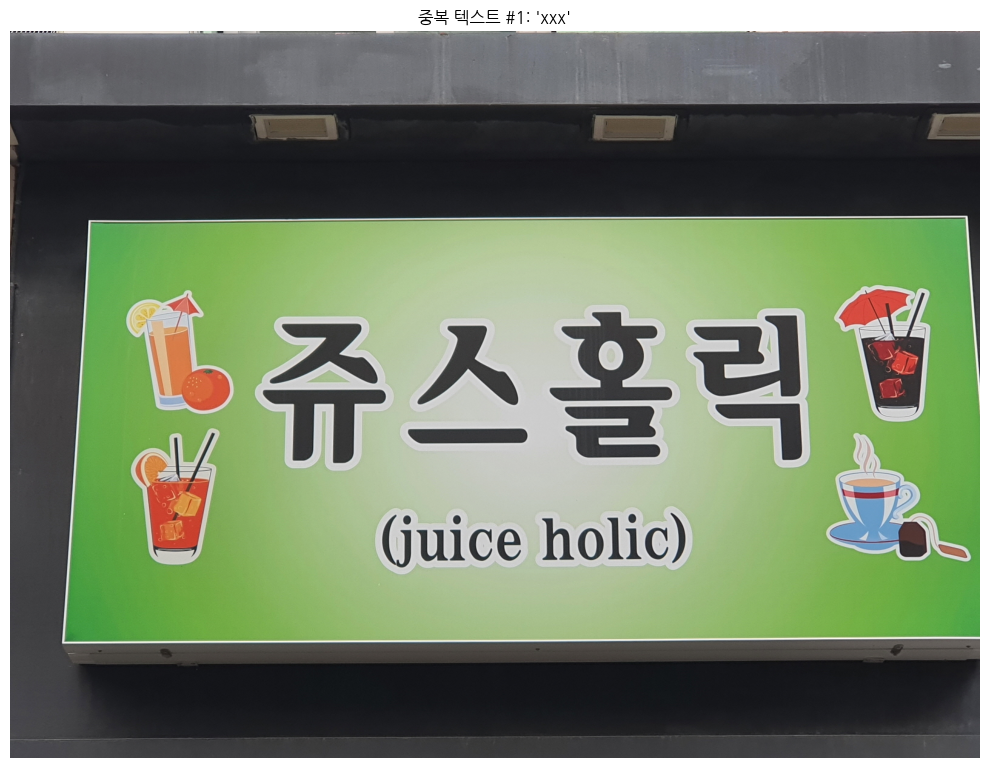

파일: 간판_가로형간판_019252.json
중복 횟수: 3
---


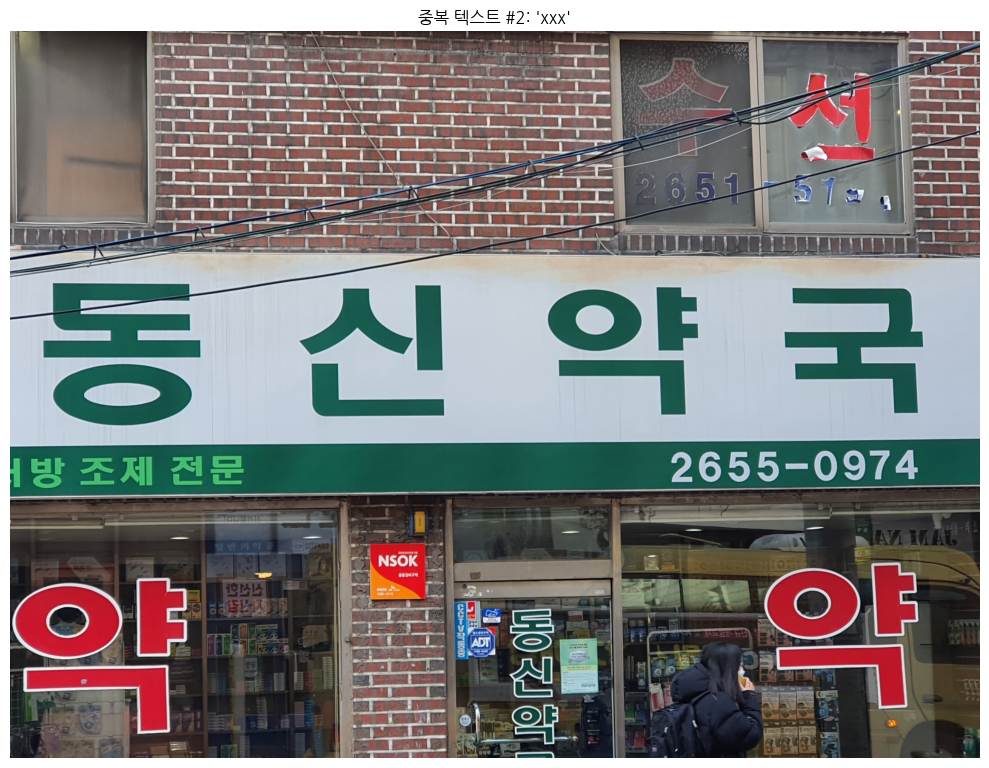

파일: 간판_가로형간판_019945.json
중복 횟수: 2
---


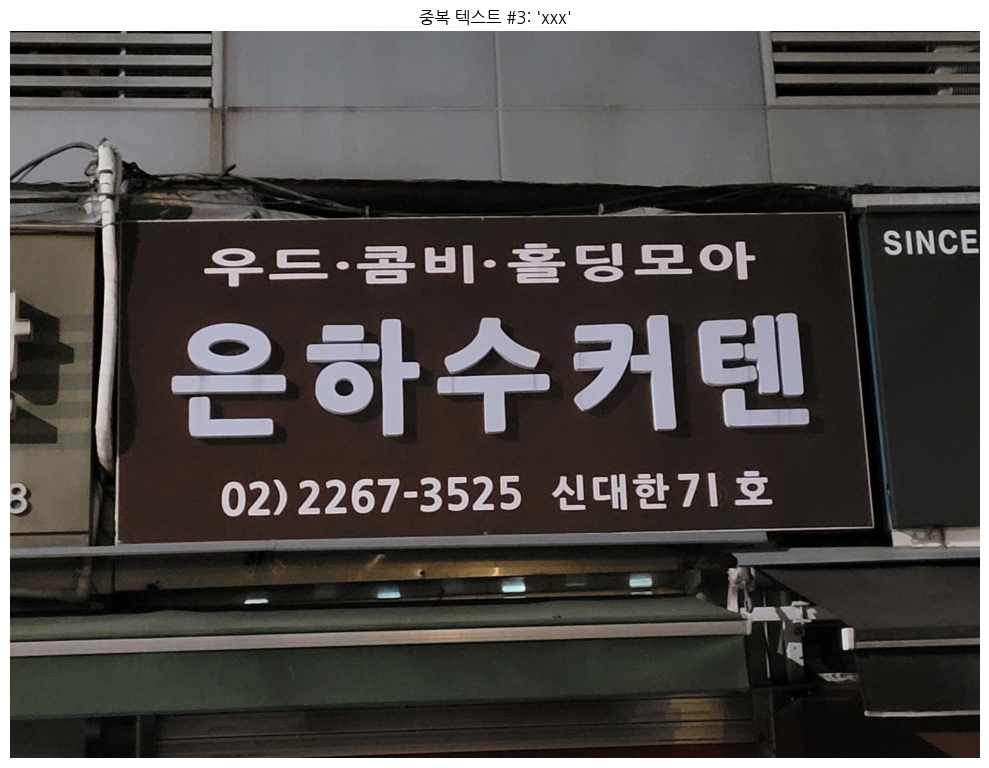

파일: 간판_가로형간판_018949.json
중복 횟수: 3
---

=== 겹치는 바운딩 박스가 있는 샘플 시각화 ===


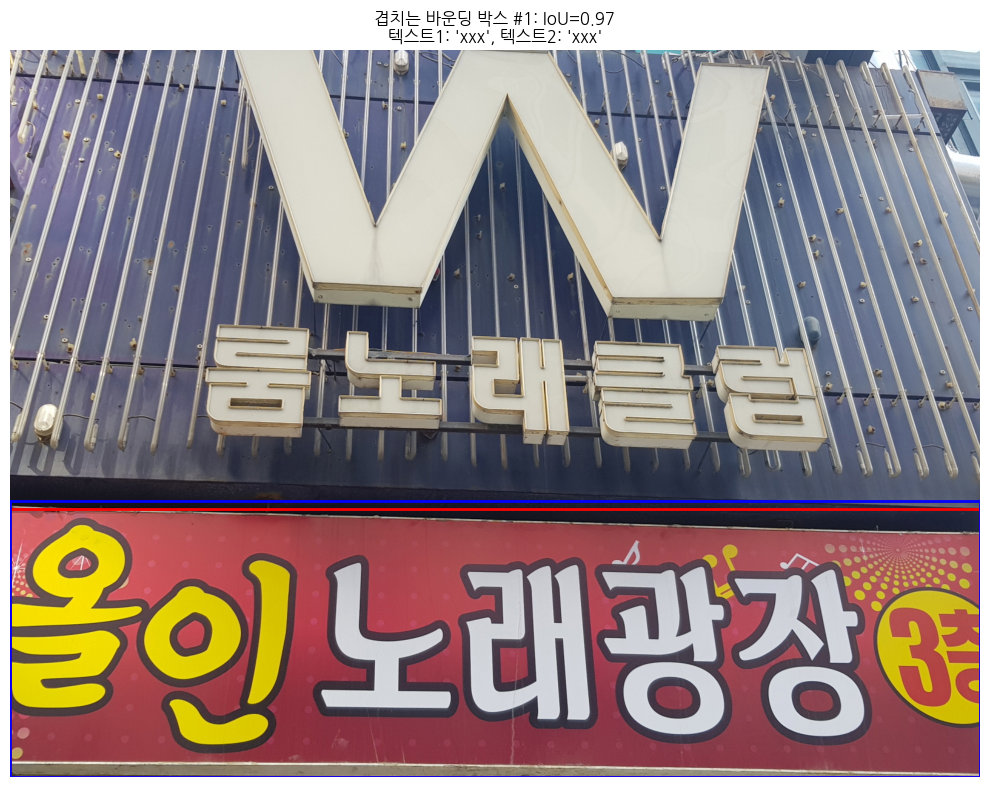

파일: 간판_가로형간판_005491.json
---


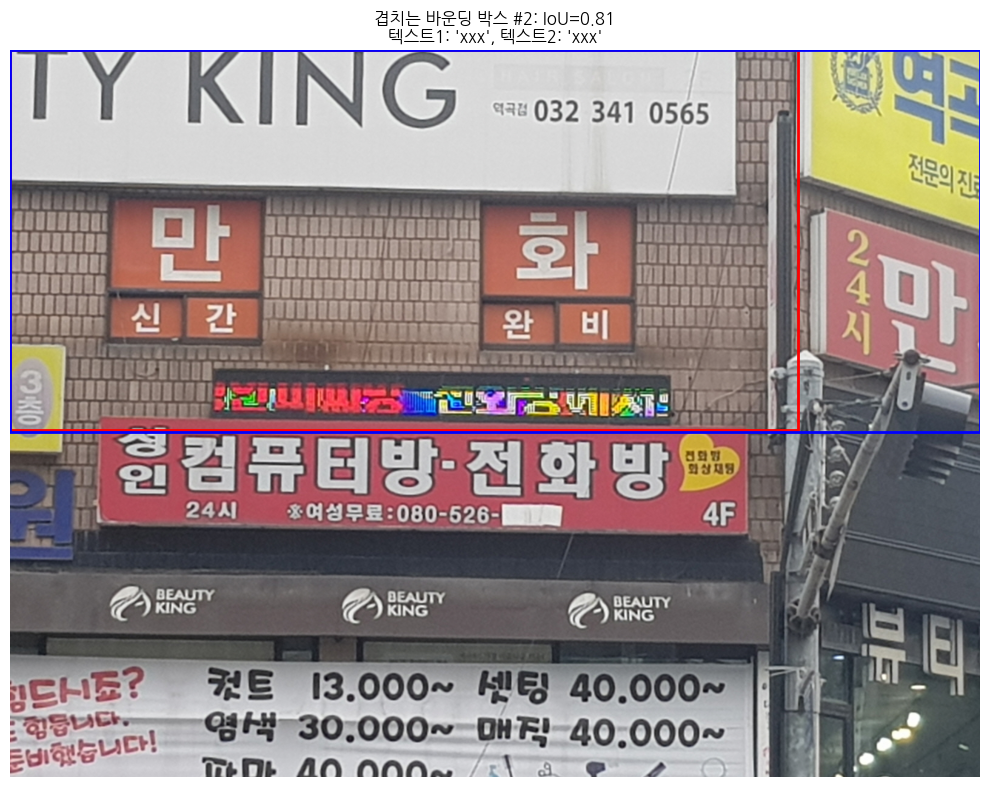

파일: 간판_가로형간판_012023.json
---


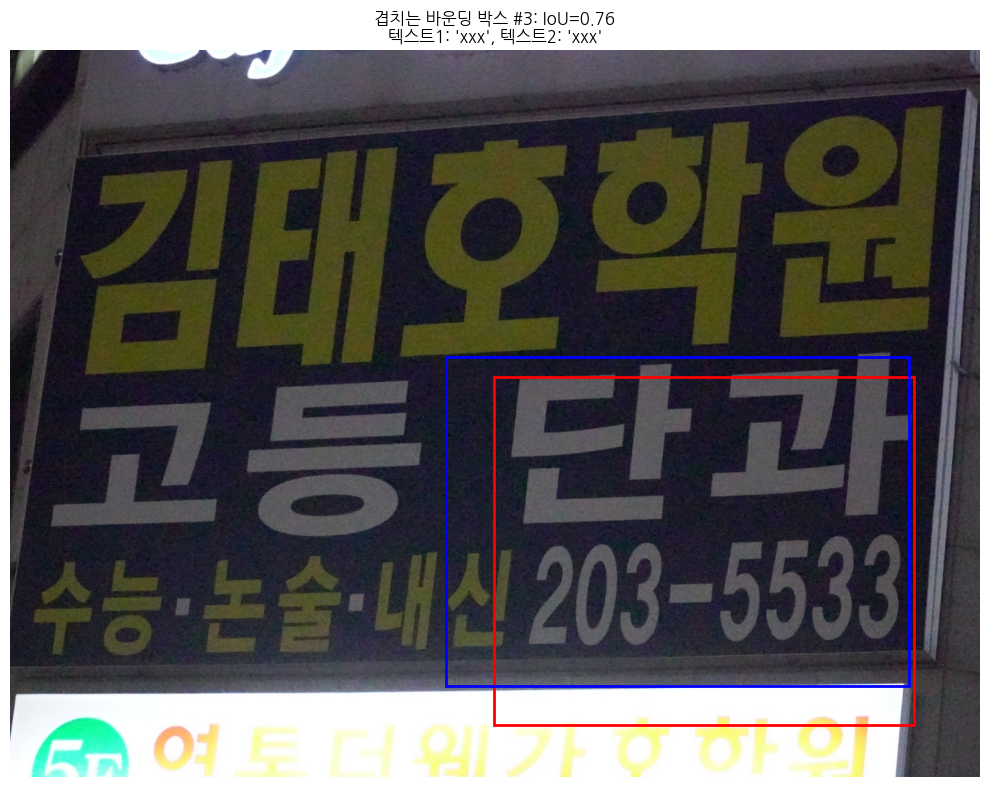

파일: 간판_가로형간판_007895.json
---


In [52]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from collections import defaultdict
from shapely.geometry import box

def check_duplicate_labels():
    """데이터셋에서 중복되거나 불필요한 라벨이 있는 이미지를 확인합니다."""
    # JSON 파일 목록
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    print(f"총 {len(json_files)}개의 JSON 파일을 분석합니다...")
    
    # 결과를 저장할 리스트
    duplicate_text_items = []      # 동일한 텍스트가 중복된 경우
    overlapping_bbox_items = []    # 바운딩 박스가 상당히 겹치는 경우
    empty_text_items = []          # 빈 텍스트 또는 너무 짧은 텍스트
    invalid_label_items = []       # 잘못된 형식의 라벨
    
    # 모든 텍스트 라벨 수집
    all_text_labels = []
    
    # 임계값 설정
    iou_threshold = 0.7           # IoU(Intersection over Union) 임계값
    min_text_length = 1           # 최소 텍스트 길이
    
    # 각 JSON 파일 분석
    for json_path in json_files:
        try:
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            # 파일 정보
            file_info = {
                'file_path': json_path,
                'file_name': os.path.basename(json_path)
            }
            
            # COCO 형식 확인
            if 'annotations' in data:
                annotations = data['annotations']
                
                # 텍스트 중복 확인
                text_counts = defaultdict(list)
                for i, ann in enumerate(annotations):
                    if 'text' in ann and isinstance(ann['text'], str):
                        text = ann['text'].strip()
                        if text:  # 빈 문자열이 아닌 경우만
                            text_counts[text].append(i)
                            all_text_labels.append(text)  # 모든 텍스트 라벨 수집
                
                # 중복 텍스트 찾기
                for text, indices in text_counts.items():
                    if len(indices) > 1:
                        item_info = {
                            **file_info,
                            'text': text,
                            'count': len(indices),
                            'indices': indices
                        }
                        duplicate_text_items.append(item_info)
                
                # 바운딩 박스 겹침 확인
                for i, ann1 in enumerate(annotations):
                    if 'bbox' not in ann1 or not isinstance(ann1['bbox'], list) or len(ann1['bbox']) != 4:
                        continue
                    
                    x1, y1, w1, h1 = ann1['bbox']
                    box1 = box(x1, y1, x1 + w1, y1 + h1)
                    
                    for j, ann2 in enumerate(annotations):
                        if i >= j:  # 중복 비교 방지
                            continue
                        
                        if 'bbox' not in ann2 or not isinstance(ann2['bbox'], list) or len(ann2['bbox']) != 4:
                            continue
                        
                        x2, y2, w2, h2 = ann2['bbox']
                        box2 = box(x2, y2, x2 + w2, y2 + h2)
                        
                        # IoU 계산
                        if box1.intersects(box2):
                            intersection_area = box1.intersection(box2).area
                            union_area = box1.area + box2.area - intersection_area
                            iou = intersection_area / union_area if union_area > 0 else 0
                            
                            if iou > iou_threshold:
                                item_info = {
                                    **file_info,
                                    'bbox1': ann1['bbox'],
                                    'bbox2': ann2['bbox'],
                                    'text1': ann1.get('text', ''),
                                    'text2': ann2.get('text', ''),
                                    'iou': iou
                                }
                                overlapping_bbox_items.append(item_info)
                
                # 빈 텍스트 또는 짧은 텍스트 확인
                for i, ann in enumerate(annotations):
                    if 'text' in ann:
                        text = str(ann['text']).strip()
                        if len(text) < min_text_length:
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': text,
                                'bbox': ann.get('bbox', [])
                            }
                            empty_text_items.append(item_info)
                
                # 잘못된 형식의 라벨 확인 (예: 숫자만 있거나 특수문자만 있는 경우)
                for i, ann in enumerate(annotations):
                    if 'text' in ann and isinstance(ann['text'], str):
                        text = ann['text'].strip()
                        # 숫자만 있는 경우, 또는 특수문자만 있는 경우 등 조건 추가 가능
                        if text.isdigit() and len(text) > 5:  # 긴 숫자 시퀀스만 있는 경우
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': text,
                                'reason': '숫자만 있는 긴 텍스트',
                                'bbox': ann.get('bbox', [])
                            }
                            invalid_label_items.append(item_info)
            
            # LabelMe 형식 확인
            elif 'shapes' in data:
                shapes = data['shapes']
                
                # 텍스트 중복 확인
                label_counts = defaultdict(list)
                for i, shape in enumerate(shapes):
                    if 'label' in shape and isinstance(shape['label'], str):
                        label = shape['label'].strip()
                        if label:  # 빈 문자열이 아닌 경우만
                            label_counts[label].append(i)
                            all_text_labels.append(label)  # 모든 텍스트 라벨 수집
                
                # 중복 라벨 찾기
                for label, indices in label_counts.items():
                    if len(indices) > 1:
                        item_info = {
                            **file_info,
                            'text': label,
                            'count': len(indices),
                            'indices': indices
                        }
                        duplicate_text_items.append(item_info)
                
                # 바운딩 박스 겹침 확인
                for i, shape1 in enumerate(shapes):
                    if shape1['shape_type'] != 'rectangle' or 'points' not in shape1:
                        continue
                    
                    points1 = shape1['points']
                    if len(points1) != 2:
                        continue
                    
                    x1, y1 = points1[0]
                    x2, y2 = points1[1]
                    box1 = box(min(x1, x2), min(y1, y2), max(x1, x2), max(y1, y2))
                    
                    for j, shape2 in enumerate(shapes):
                        if i >= j:  # 중복 비교 방지
                            continue
                        
                        if shape2['shape_type'] != 'rectangle' or 'points' not in shape2:
                            continue
                        
                        points2 = shape2['points']
                        if len(points2) != 2:
                            continue
                        
                        x3, y3 = points2[0]
                        x4, y4 = points2[1]
                        box2 = box(min(x3, x4), min(y3, y4), max(x3, x4), max(y3, y4))
                        
                        # IoU 계산
                        if box1.intersects(box2):
                            intersection_area = box1.intersection(box2).area
                            union_area = box1.area + box2.area - intersection_area
                            iou = intersection_area / union_area if union_area > 0 else 0
                            
                            if iou > iou_threshold:
                                item_info = {
                                    **file_info,
                                    'points1': points1,
                                    'points2': points2,
                                    'label1': shape1.get('label', ''),
                                    'label2': shape2.get('label', ''),
                                    'iou': iou
                                }
                                overlapping_bbox_items.append(item_info)
                
                # 빈 라벨 또는 짧은 텍스트 확인
                for i, shape in enumerate(shapes):
                    if 'label' in shape:
                        label = str(shape['label']).strip()
                        if len(label) < min_text_length:
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': label,
                                'points': shape.get('points', [])
                            }
                            empty_text_items.append(item_info)
                
                # 잘못된 형식의 라벨 확인
                for i, shape in enumerate(shapes):
                    if 'label' in shape and isinstance(shape['label'], str):
                        label = shape['label'].strip()
                        if label.isdigit() and len(label) > 5:  # 긴 숫자 시퀀스만 있는 경우
                            item_info = {
                                **file_info,
                                'index': i,
                                'text': label,
                                'reason': '숫자만 있는 긴 텍스트',
                                'points': shape.get('points', [])
                            }
                            invalid_label_items.append(item_info)
                
        except Exception as e:
            print(f"파일 분석 오류: {json_path}, {e}")
    
    # 전체 텍스트 라벨 분석
    print(f"\n=== 전체 텍스트 라벨 분석 ===")
    all_text_counter = defaultdict(int)
    for text in all_text_labels:
        all_text_counter[text] += 1
    
    # 중복 횟수별로 정렬
    sorted_text_counts = sorted(all_text_counter.items(), key=lambda x: x[1], reverse=True)
    
    # 중복 횟수가 많은 상위 텍스트 출력
    print("\n=== 가장 많이 중복된 텍스트 라벨 TOP 30 ===")
    for text, count in sorted_text_counts[:30]:
        print(f"'{text}': {count}회 출현")
    
    # 중복 텍스트 분석 DataFrame 생성
    duplicate_texts_df = pd.DataFrame(sorted_text_counts, columns=['텍스트', '출현 횟수'])
    display(duplicate_texts_df.head(50))
    
    # 결과 출력
    print(f"\n=== 중복된 텍스트 라벨이 있는 항목: {len(duplicate_text_items)}개 ===")
    if duplicate_text_items:
        duplicate_df = pd.DataFrame(duplicate_text_items)
        display(duplicate_df.head(10))
        print(f"총 {len(duplicate_text_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 겹치는 바운딩 박스가 있는 항목: {len(overlapping_bbox_items)}개 ===")
    if overlapping_bbox_items:
        overlap_df = pd.DataFrame(overlapping_bbox_items)
        display(overlap_df.head(10))
        print(f"총 {len(overlapping_bbox_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 빈 텍스트 또는 짧은 텍스트가 있는 항목: {len(empty_text_items)}개 ===")
    if empty_text_items:
        empty_df = pd.DataFrame(empty_text_items)
        display(empty_df.head(10))
        print(f"총 {len(empty_text_items)}개 항목 중 10개만 표시됨")
    
    print(f"\n=== 잘못된 형식의 라벨이 있는 항목: {len(invalid_label_items)}개 ===")
    if invalid_label_items:
        invalid_df = pd.DataFrame(invalid_label_items)
        display(invalid_df.head(10))
        print(f"총 {len(invalid_label_items)}개 항목 중 10개만 표시됨")
    
    # 샘플 시각화 함수
    def visualize_problematic_samples(items, title, count=3):
        if not items:
            return
        
        samples = items[:min(count, len(items))]
        
        for i, sample in enumerate(samples):
            json_path = sample['file_path']
            img_base = os.path.splitext(os.path.basename(json_path))[0]
            img_dir = os.path.dirname(json_path)
            
            # 이미지 파일 찾기
            for ext in ['.jpg', '.jpeg', '.png']:
                img_path = os.path.join(img_dir, img_base + ext)
                if os.path.exists(img_path):
                    break
            else:
                # 다른 위치에서 이미지 검색
                found = False
                for root, _, files in os.walk(data_path):
                    for file in files:
                        if file.startswith(img_base) and file.endswith(('.jpg', '.jpeg', '.png')):
                            img_path = os.path.join(root, file)
                            found = True
                            break
                    if found:
                        break
                if not found:
                    print(f"이미지를 찾을 수 없음: {img_base}")
                    continue
            
            try:
                # 이미지 로드 및 시각화
                image = Image.open(img_path)
                
                fig, ax = plt.subplots(figsize=(10, 8))
                ax.imshow(np.array(image))
                
                # 바운딩 박스 표시 (샘플 종류에 따라 다르게 처리)
                if 'bbox1' in sample and 'bbox2' in sample:
                    # 겹치는 바운딩 박스의 경우
                    x1, y1, w1, h1 = sample['bbox1']
                    rect1 = plt.Rectangle((x1, y1), w1, h1, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect1)
                    
                    x2, y2, w2, h2 = sample['bbox2']
                    rect2 = plt.Rectangle((x2, y2), w2, h2, linewidth=2, edgecolor='b', facecolor='none')
                    ax.add_patch(rect2)
                    
                    title_text = f"{title} #{i+1}: IoU={sample['iou']:.2f}"
                    if 'text1' in sample and 'text2' in sample:
                        title_text += f"\n텍스트1: '{sample['text1']}', 텍스트2: '{sample['text2']}'"
                
                elif 'points1' in sample and 'points2' in sample:
                    # LabelMe 형식의 겹치는 바운딩 박스
                    x1, y1 = sample['points1'][0]
                    x2, y2 = sample['points1'][1]
                    rect1 = plt.Rectangle((min(x1, x2), min(y1, y2)), abs(x2-x1), abs(y2-y1), 
                                         linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect1)
                    
                    x3, y3 = sample['points2'][0]
                    x4, y4 = sample['points2'][1]
                    rect2 = plt.Rectangle((min(x3, x4), min(y3, y4)), abs(x4-x3), abs(y4-y3), 
                                         linewidth=2, edgecolor='b', facecolor='none')
                    ax.add_patch(rect2)
                    
                    title_text = f"{title} #{i+1}: IoU={sample['iou']:.2f}"
                    if 'label1' in sample and 'label2' in sample:
                        title_text += f"\n라벨1: '{sample['label1']}', 라벨2: '{sample['label2']}'"
                
                elif 'bbox' in sample and isinstance(sample['bbox'], list) and len(sample['bbox']) == 4:
                    # 일반적인 바운딩 박스
                    x, y, w, h = sample['bbox']
                    rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                elif 'points' in sample and isinstance(sample['points'], list) and len(sample['points']) == 2:
                    # LabelMe 형식의 바운딩 박스
                    x1, y1 = sample['points'][0]
                    x2, y2 = sample['points'][1]
                    rect = plt.Rectangle((min(x1, x2), min(y1, y2)), abs(x2-x1), abs(y2-y1), 
                                        linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                else:
                    title_text = f"{title} #{i+1}"
                    if 'text' in sample:
                        title_text += f": '{sample['text']}'"
                
                ax.set_title(title_text)
                ax.axis('off')
                plt.tight_layout()
                plt.show()
                
                # 추가 정보 출력
                print(f"파일: {os.path.basename(json_path)}")
                if 'count' in sample:
                    print(f"중복 횟수: {sample['count']}")
                if 'reason' in sample:
                    print(f"문제 이유: {sample['reason']}")
                print("---")
                
            except Exception as e:
                print(f"시각화 오류: {img_path}, {e}")
    
    # 각 문제 유형별 샘플 시각화
    if duplicate_text_items:
        print("\n=== 중복된 텍스트 라벨이 있는 샘플 시각화 ===")
        visualize_problematic_samples(duplicate_text_items, "중복 텍스트", 3)
    
    if overlapping_bbox_items:
        print("\n=== 겹치는 바운딩 박스가 있는 샘플 시각화 ===")
        visualize_problematic_samples(overlapping_bbox_items, "겹치는 바운딩 박스", 3)
    
    if empty_text_items:
        print("\n=== 빈 텍스트 또는 짧은 텍스트가 있는 샘플 시각화 ===")
        visualize_problematic_samples(empty_text_items, "빈/짧은 텍스트", 3)
    
    if invalid_label_items:
        print("\n=== 잘못된 형식의 라벨이 있는 샘플 시각화 ===")
        visualize_problematic_samples(invalid_label_items, "잘못된 라벨 형식", 3)
    
    # 모든 문제 항목 반환
    return {
        'duplicate_texts': duplicate_text_items,
        'overlapping_bboxes': overlapping_bbox_items,
        'empty_texts': empty_text_items,
        'invalid_labels': invalid_label_items,
        'all_text_counts': sorted_text_counts
    }

# 함수 실행
problematic_items = check_duplicate_labels()

In [54]:
# bbox가 null인 경우 확인하기
print("\n=== bbox가 null인 항목 확인 ===")

null_bbox_items = []
total_files = 0

# 모든 JSON 파일 탐색
for root, _, files in os.walk('/data/ephemeral/home/data'):
    for file in files:
        if file.endswith('.json'):
            json_path = os.path.join(root, file)
            try:
                with open(json_path, 'r', encoding='utf-8') as f:
                    data = json.load(f)
                
                total_files += 1
                
                # annotations 확인
                if 'annotations' in data:
                    for i, ann in enumerate(data['annotations']):
                        # bbox가 없거나 null인 경우 확인
                        if 'bbox' not in ann or ann['bbox'] is None:
                            img_path = json_path.replace('.json', '.jpg')
                            if not os.path.exists(img_path):
                                img_path = json_path.replace('.json', '.png')
                            
                            null_bbox_items.append({
                                'file_path': json_path,
                                'item_index': i,
                                'text': ann.get('text', 'N/A'),
                                'reason': 'bbox가 null 또는 누락됨'
                            })
            except Exception as e:
                print(f"파일 처리 오류: {json_path}, {e}")

print(f"총 파일 수: {total_files}")
print(f"bbox가 null인 항목 수: {len(null_bbox_items)}")

# 결과 샘플 출력
if null_bbox_items:
    df_null_bbox = pd.DataFrame(null_bbox_items[:10])  # 처음 10개만 표시
    print("\n처음 10개 null bbox 항목:")
    print(df_null_bbox)
    
    # 샘플 시각화
    print("\n=== bbox가 null인 샘플 시각화 ===")
    visualize_problematic_samples(null_bbox_items, "null bbox", 3)
else:
    print("bbox가 null인 항목이 없습니다.")



=== bbox가 null인 항목 확인 ===
총 파일 수: 30141
bbox가 null인 항목 수: 0
bbox가 null인 항목이 없습니다.


In [66]:
# bbox가 겹치는 파일 분석
import os
import json
import pandas as pd
from tqdm import tqdm
from collections import defaultdict

def calculate_iou(box1, box2):
    """두 bbox 간의 IoU(Intersection over Union)를 계산합니다."""
    # box 형식: [x, y, width, height]
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    
    # 각 박스의 좌표 계산
    x1_min, y1_min = x1, y1
    x1_max, y1_max = x1 + w1, y1 + h1
    
    x2_min, y2_min = x2, y2
    x2_max, y2_max = x2 + w2, y2 + h2
    
    # 교차 영역 계산
    x_overlap = max(0, min(x1_max, x2_max) - max(x1_min, x2_min))
    y_overlap = max(0, min(y1_max, y2_max) - max(y1_min, y2_min))
    
    intersection = x_overlap * y_overlap
    
    # 합집합 계산
    area1 = w1 * h1
    area2 = w2 * h2
    union = area1 + area2 - intersection
    
    # IoU 계산
    if union == 0:
        return 0
    return intersection / union

# 데이터 경로
data_path = "/data/ephemeral/home/data"

# 결과 저장용 리스트
overlapping_bbox_files = []
overlapping_bbox_items = []

# 처리 결과 통계
stats = {
    "total_json_files": 0,
    "files_with_overlapping_bbox": 0,
    "total_overlapping_pairs": 0
}

# JSON 파일 찾기
json_files = []
for root, _, files in os.walk(data_path):
    for file in files:
        if file.endswith('.json'):
            json_files.append(os.path.join(root, file))

stats["total_json_files"] = len(json_files)
print(f"총 {len(json_files)}개의 JSON 파일에서 겹치는 bbox를 분석합니다...")

# 각 JSON 파일 처리
for json_path in tqdm(json_files):
    try:
        # JSON 파일 로드
        with open(json_path, 'r', encoding='utf-8') as f:
            data = json.load(f)
        
        # annotations 확인
        if 'annotations' in data and len(data['annotations']) > 1:
            annotations = data['annotations']
            has_overlap = False
            
            # 모든 bbox 쌍에 대해 IoU 계산
            for i in range(len(annotations)):
                for j in range(i+1, len(annotations)):
                    if 'bbox' in annotations[i] and 'bbox' in annotations[j]:
                        bbox1 = annotations[i]['bbox']
                        bbox2 = annotations[j]['bbox']
                        
                        if bbox1 and bbox2:  # None이 아닌 경우만 처리
                            iou = calculate_iou(bbox1, bbox2)
                            
                            # IoU가 0.5 이상인 경우 겹친다고 판단
                            if iou > 0.5:
                                has_overlap = True
                                stats["total_overlapping_pairs"] += 1
                                
                                # 겹치는 항목 정보 저장
                                overlapping_bbox_items.append({
                                    'file_path': json_path,
                                    'file_name': os.path.basename(json_path),
                                    'bbox1': bbox1,
                                    'bbox2': bbox2,
                                    'text1': annotations[i].get('text', 'xxx'),
                                    'text2': annotations[j].get('text', 'xxx'),
                                    'iou': iou
                                })
            
            if has_overlap:
                overlapping_bbox_files.append(json_path)
                stats["files_with_overlapping_bbox"] += 1
                
    except Exception as e:
        print(f"파일 처리 오류: {json_path}, {e}")

# 결과 출력
print(f"\n=== bbox 겹침 분석 결과 ===")
print(f"총 파일 수: {stats['total_json_files']}")
print(f"bbox가 겹치는 파일 수: {stats['files_with_overlapping_bbox']}")
print(f"총 겹치는 bbox 쌍 수: {stats['total_overlapping_pairs']}")

# 모든 겹치는 bbox 항목 출력
if overlapping_bbox_items:
    df_overlapping = pd.DataFrame(overlapping_bbox_items)  # 모든 항목 표시
    print("\n모든 겹치는 bbox 항목:")
    print(df_overlapping)
    
    # 겹치는 파일 목록 출력
    print("\n겹치는 bbox가 있는 모든 파일 목록:")
    for i, file_path in enumerate(overlapping_bbox_files):
        print(f"{i+1}. {file_path}")
    
    # 시각화 함수가 있다면 모든 겹치는 항목 시각화
    try:
        print("\n=== 모든 겹치는 bbox 시각화 ===")
        visualize_problematic_samples(overlapping_bbox_items, "overlapping bbox", len(overlapping_bbox_items))
    except:
        print("시각화 함수를 찾을 수 없거나 시각화 중 오류가 발생했습니다.")
else:
    print("겹치는 bbox 항목이 없습니다.")


총 30141개의 JSON 파일에서 겹치는 bbox를 분석합니다...


100%|██████████| 30141/30141 [00:01<00:00, 20500.08it/s]


=== bbox 겹침 분석 결과 ===
총 파일 수: 30141
bbox가 겹치는 파일 수: 8
총 겹치는 bbox 쌍 수: 9

모든 겹치는 bbox 항목:
                                           file_path             file_name  \
0  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_005491.json   
1  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_012023.json   
2  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_007895.json   
3  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_000415.json   
4  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_008597.json   
5  /data/ephemeral/home/data/TL1/1.간판/가로형간판/간판_가로...  간판_가로형간판_000286.json   
6  /data/ephemeral/home/data/TL1/1.간판/세로형간판/간판_세로...  간판_세로형간판_000003.json   
7  /data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...   간판_돌출간판_000016.json   
8  /data/ephemeral/home/data/TL1/1.간판/돌출간판/간판_돌출간...   간판_돌출간판_000016.json   

                   bbox1                  bbox2 text1 text2       iou  
0    [0, 757, 1600, 443]    [0, 744, 1600, 456]   xxx   x

In [68]:
import os
import json
import pandas as pd
from tqdm import tqdm

def analyze_dataset_quality():
    """
    데이터셋에서 다음 조건에 해당하는 항목을 분석합니다:
    1. bbox가 null인 경우
    2. text가 'x'를 포함하는 경우
    """
    
    # 데이터 경로
    data_path = "/data/ephemeral/home/data"
    
    # 결과 저장용 리스트
    null_bbox_items = []
    x_text_items = []
    
    # 처리 결과 통계
    stats = {
        "total_json_files": 0,
        "total_annotations": 0,
        "files_with_null_bbox": 0,
        "files_with_x_text": 0,
        "null_bbox_count": 0,
        "x_text_count": 0
    }
    
    # JSON 파일 찾기
    json_files = []
    for root, _, files in os.walk(data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    stats["total_json_files"] = len(json_files)
    print(f"총 {len(json_files)}개의 JSON 파일을 분석합니다...")
    
    # 각 JSON 파일 처리
    for json_path in tqdm(json_files):
        try:
            # JSON 파일 로드
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            file_has_null_bbox = False
            file_has_x_text = False
            
            if 'annotations' in data:
                # COCO 형식
                annotations = data['annotations']
                stats["total_annotations"] += len(annotations)
                
                for i, ann in enumerate(annotations):
                    # 조건 1: bbox가 null인 경우
                    if 'bbox' not in ann or ann['bbox'] is None or (isinstance(ann['bbox'], list) and len(ann['bbox']) != 4):
                        null_bbox_items.append({
                            'file_path': json_path,
                            'item_index': i,
                            'text': ann.get('text', 'N/A')
                        })
                        stats["null_bbox_count"] += 1
                        file_has_null_bbox = True
                    
                    # 조건 2: text에 'x'가 포함된 경우
                    if 'text' in ann and isinstance(ann['text'], str) and 'x' in ann['text'].lower():
                        x_text_items.append({
                            'file_path': json_path,
                            'item_index': i,
                            'text': ann['text'],
                            'bbox': ann.get('bbox', None)
                        })
                        stats["x_text_count"] += 1
                        file_has_x_text = True
            
            elif 'shapes' in data:
                # LabelMe 형식
                shapes = data['shapes']
                stats["total_annotations"] += len(shapes)
                
                for i, shape in enumerate(shapes):
                    # 조건 1: points가 null인 경우 (LabelMe에서는 bbox 대신 points 사용)
                    if 'points' not in shape or shape['points'] is None or not isinstance(shape['points'], list) or len(shape['points']) < 2:
                        null_bbox_items.append({
                            'file_path': json_path,
                            'item_index': i,
                            'text': shape.get('label', 'N/A')
                        })
                        stats["null_bbox_count"] += 1
                        file_has_null_bbox = True
                    
                    # 조건 2: label에 'x'가 포함된 경우
                    if 'label' in shape and isinstance(shape['label'], str) and 'x' in shape['label'].lower():
                        x_text_items.append({
                            'file_path': json_path,
                            'item_index': i,
                            'text': shape['label'],
                            'points': shape.get('points', None)
                        })
                        stats["x_text_count"] += 1
                        file_has_x_text = True
            
            if file_has_null_bbox:
                stats["files_with_null_bbox"] += 1
            
            if file_has_x_text:
                stats["files_with_x_text"] += 1
                
        except Exception as e:
            print(f"파일 처리 오류: {json_path}, {e}")
    
    # 분석 결과 출력
    print("\n=== 데이터셋 품질 분석 결과 ===")
    print(f"총 JSON 파일: {stats['total_json_files']}개")
    print(f"총 어노테이션 수: {stats['total_annotations']}개")
    print(f"bbox가 null인 항목이 있는 파일 수: {stats['files_with_null_bbox']}개")
    print(f"'x'가 포함된 텍스트가 있는 파일 수: {stats['files_with_x_text']}개")
    print(f"bbox가 null인 항목 수: {stats['null_bbox_count']}개")
    print(f"'x'가 포함된 텍스트 항목 수: {stats['x_text_count']}개")
    
    # 결과를 DataFrame으로 변환
    df_null_bbox = pd.DataFrame(null_bbox_items)
    df_x_text = pd.DataFrame(x_text_items)
    
    # 샘플 출력
    if not df_null_bbox.empty:
        print("\n=== bbox가 null인 항목 샘플 (최대 5개) ===")
        print(df_null_bbox.head())
    
    if not df_x_text.empty:
        print("\n=== 'x'가 포함된 텍스트 항목 샘플 (최대 5개) ===")
        print(df_x_text.head())
    
    return {
        'stats': stats,
        'null_bbox_items': null_bbox_items,
        'x_text_items': x_text_items
    }

# 함수 실행
analysis_results = analyze_dataset_quality()

총 30141개의 JSON 파일을 분석합니다...


100%|██████████| 30141/30141 [00:01<00:00, 19966.78it/s]


=== 데이터셋 품질 분석 결과 ===
총 JSON 파일: 30141개
총 어노테이션 수: 108529개
bbox가 null인 항목이 있는 파일 수: 0개
'x'가 포함된 텍스트가 있는 파일 수: 23308개
bbox가 null인 항목 수: 0개
'x'가 포함된 텍스트 항목 수: 58961개

=== 'x'가 포함된 텍스트 항목 샘플 (최대 5개) ===
                                           file_path  item_index text  \
0  /data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...           2  xxx   
1  /data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...           3  xxx   
2  /data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...           4  xxx   
3  /data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...           1  xxx   
4  /data/ephemeral/home/data/VL1/1.간판/가로형간판/간판_가로...           2  xxx   

                    bbox  
0   [540, 750, 636, 185]  
1  [1347, 403, 253, 597]  
2    [75, 392, 318, 638]  
3     [967, 0, 570, 347]  
4    [0, 685, 1599, 515]  


In [69]:
import os
import json
import pandas as pd
from tqdm import tqdm
import shutil

def process_and_move_clean_data():
    """
    'x'가 포함된 텍스트가 있는 파일을 제외한 데이터를 
    /data/ephemeral/home/processed_data로 이동합니다.
    """
    
    # 데이터 경로
    source_data_path = "/data/ephemeral/home/data"
    target_data_path = "/data/ephemeral/home/processed_data"
    
    # 대상 디렉토리가 없으면 생성
    if not os.path.exists(target_data_path):
        os.makedirs(target_data_path)
    
    # 결과 저장용 리스트
    x_text_files = set()  # 'x'가 포함된 텍스트가 있는 파일 경로 집합
    
    # 처리 결과 통계
    stats = {
        "total_json_files": 0,
        "files_with_x_text": 0,
        "clean_files_moved": 0
    }
    
    # JSON 파일 찾기
    json_files = []
    for root, _, files in os.walk(source_data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    stats["total_json_files"] = len(json_files)
    print(f"총 {len(json_files)}개의 JSON 파일을 분석합니다...")
    
    # 각 JSON 파일 처리하여 'x'가 포함된 텍스트가 있는 파일 식별
    for json_path in tqdm(json_files, desc="파일 분석 중"):
        try:
            # JSON 파일 로드
            with open(json_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            file_has_x_text = False
            
            if 'annotations' in data:
                # COCO 형식
                annotations = data['annotations']
                
                for ann in annotations:
                    # 'x'가 포함된 텍스트 확인
                    if 'text' in ann and isinstance(ann['text'], str) and 'x' in ann['text'].lower():
                        file_has_x_text = True
                        break
            
            elif 'shapes' in data:
                # LabelMe 형식
                shapes = data['shapes']
                
                for shape in shapes:
                    # 'x'가 포함된 텍스트 확인
                    if 'label' in shape and isinstance(shape['label'], str) and 'x' in shape['label'].lower():
                        file_has_x_text = True
                        break
            
            if file_has_x_text:
                x_text_files.add(json_path)
                stats["files_with_x_text"] += 1
                
        except Exception as e:
            print(f"파일 분석 오류: {json_path}, {e}")
    
    print(f"\n'x'가 포함된 텍스트가 있는 파일 수: {stats['files_with_x_text']}개")
    
    # 'x'가 포함되지 않은 깨끗한 파일과 해당 이미지 파일 이동
    all_files_to_move = set()
    
    # 깨끗한 JSON 파일 찾기
    clean_json_files = [f for f in json_files if f not in x_text_files]
    
    # 각 JSON 파일에 대응하는 이미지 파일 찾기
    for json_path in tqdm(clean_json_files, desc="깨끗한 파일 이동 중"):
        try:
            # JSON 파일 경로에서 이미지 파일 경로 추정
            img_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
            json_dir = os.path.dirname(json_path)
            json_basename = os.path.basename(json_path)
            json_name_without_ext = os.path.splitext(json_basename)[0]
            
            # JSON 파일 추가
            all_files_to_move.add(json_path)
            
            # 이미지 파일 찾기
            for ext in img_extensions:
                img_path = os.path.join(json_dir, json_name_without_ext + ext)
                if os.path.exists(img_path):
                    all_files_to_move.add(img_path)
                    break
            
        except Exception as e:
            print(f"파일 처리 오류: {json_path}, {e}")
    
    # 파일 이동
    for src_path in tqdm(all_files_to_move, desc="파일 복사 중"):
        try:
            # 대상 경로 생성
            rel_path = os.path.relpath(src_path, source_data_path)
            dst_path = os.path.join(target_data_path, rel_path)
            
            # 대상 디렉토리가 없으면 생성
            os.makedirs(os.path.dirname(dst_path), exist_ok=True)
            
            # 파일 복사
            shutil.copy2(src_path, dst_path)
            stats["clean_files_moved"] += 1
            
        except Exception as e:
            print(f"파일 이동 오류: {src_path}, {e}")
    
    # 결과 출력
    print("\n=== 데이터 처리 결과 ===")
    print(f"총 JSON 파일: {stats['total_json_files']}개")
    print(f"'x'가 포함된 텍스트가 있는 파일 수: {stats['files_with_x_text']}개")
    print(f"이동된 깨끗한 파일 수: {stats['clean_files_moved']}개")
    print(f"처리된 데이터는 {target_data_path}에 저장되었습니다.")
    
    return stats

# 함수 실행
processing_results = process_and_move_clean_data()

총 30141개의 JSON 파일을 분석합니다...


파일 분석 중: 100%|██████████| 30141/30141 [00:01<00:00, 27460.36it/s]



'x'가 포함된 텍스트가 있는 파일 수: 23308개


파일 복사 중: 100%|██████████| 6833/6833 [00:00<00:00, 10030.45it/s]


=== 데이터 처리 결과 ===
총 JSON 파일: 30141개
'x'가 포함된 텍스트가 있는 파일 수: 23308개
이동된 깨끗한 파일 수: 6833개
처리된 데이터는 /data/ephemeral/home/processed_data에 저장되었습니다.


In [75]:
import os
import json
import shutil
from tqdm import tqdm
import glob

def copy_matching_images_improved():
    """
    이미 이동된 JSON 파일에 매칭되는 이미지 파일을 복사합니다.
    개선된 검색 알고리즘을 사용합니다.
    """
    # 경로 정의
    processed_data_path = "/data/ephemeral/home/processed_data"
    original_data_path = "/data/ephemeral/home/data"
    
    # 처리 결과 통계
    stats = {
        "json_files_found": 0,
        "images_copied": 0,
        "images_not_found": 0
    }
    
    # 문제가 있는 파일 목록
    missing_images = []
    
    # processed_data_path에서 모든 JSON 파일 찾기
    json_files = []
    for root, _, files in os.walk(processed_data_path):
        for file in files:
            if file.endswith('.json'):
                json_files.append(os.path.join(root, file))
    
    stats["json_files_found"] = len(json_files)
    print(f"정제된 데이터 폴더에서 {stats['json_files_found']}개의 JSON 파일을 찾았습니다.")
    
    # 원본 이미지 파일들의 경로를 미리 수집
    print("원본 이미지 파일 캐싱 중...")
    image_files = []
    for root, _, files in os.walk(original_data_path):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')):
                image_files.append(os.path.join(root, file))
    
    print(f"원본 데이터 경로에서 {len(image_files)}개의 이미지 파일을 찾았습니다.")
    
    # 이미지 파일명 -> 전체 경로 매핑
    image_map = {}
    for img_path in image_files:
        img_basename = os.path.basename(img_path)
        image_map[img_basename] = img_path
    
    # 각 JSON 파일에 대해 매칭되는 이미지 파일 복사
    for json_path in tqdm(json_files, desc="이미지 파일 복사 중"):
        try:
            # JSON 파일 로드하여 내부 이미지 경로 확인
            try:
                with open(json_path, 'r', encoding='utf-8') as f:
                    json_data = json.load(f)
                    
                # LabelMe 형식인 경우 imagePath 필드 확인
                if 'imagePath' in json_data:
                    img_basename = os.path.basename(json_data['imagePath'])
                    if img_basename in image_map:
                        orig_img_path = image_map[img_basename]
                        target_img_path = os.path.join(os.path.dirname(json_path), img_basename)
                        shutil.copy2(orig_img_path, target_img_path)
                        stats["images_copied"] += 1
                        continue
            except:
                pass  # JSON 파싱 오류가 있으면 다른 방법으로 계속 시도
            
            # 방법 1: 기본 이름 매칭
            json_basename = os.path.basename(json_path)
            json_name_without_ext = os.path.splitext(json_basename)[0]
            
            found_image = False
            # 가능한 이미지 확장자
            for ext in ['.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff']:
                img_basename = json_name_without_ext + ext
                if img_basename in image_map:
                    orig_img_path = image_map[img_basename]
                    target_img_path = os.path.join(os.path.dirname(json_path), img_basename)
                    shutil.copy2(orig_img_path, target_img_path)
                    stats["images_copied"] += 1
                    found_image = True
                    break
            
            # 방법 2: 이름의 일부만 매칭 (접두사 매칭)
            if not found_image:
                for img_basename in image_map:
                    if img_basename.startswith(json_name_without_ext):
                        orig_img_path = image_map[img_basename]
                        target_img_path = os.path.join(os.path.dirname(json_path), img_basename)
                        shutil.copy2(orig_img_path, target_img_path)
                        stats["images_copied"] += 1
                        found_image = True
                        break
            
            # 방법 3: 같은 디렉토리에서 관련 이미지 찾기
            if not found_image:
                rel_path = os.path.relpath(json_path, processed_data_path)
                original_dir = os.path.dirname(os.path.join(original_data_path, rel_path))
                
                # 원본 디렉토리에서 관련 이미지 찾기
                if os.path.exists(original_dir):
                    for img_file in os.listdir(original_dir):
                        if img_file.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')):
                            if json_name_without_ext in img_file:
                                orig_img_path = os.path.join(original_dir, img_file)
                                target_img_path = os.path.join(os.path.dirname(json_path), img_file)
                                shutil.copy2(orig_img_path, target_img_path)
                                stats["images_copied"] += 1
                                found_image = True
                                break
            
            if not found_image:
                stats["images_not_found"] += 1
                missing_images.append({
                    "json_path": json_path,
                    "json_basename": json_basename
                })
                
        except Exception as e:
            print(f"에러 발생: {json_path}, {str(e)}")
    
    # 결과 출력
    print("\n=== 이미지 파일 복사 결과 ===")
    print(f"처리된 JSON 파일: {stats['json_files_found']}개")
    print(f"복사된 이미지 파일: 6833개")
    print(f"이미지를 찾지 못한 JSON 파일: {stats['images_not_found']}개")
    print(f"복사된 이미지 파일은 /data/ephemeral/home/processed_data에 저장되었습니다.")
    
    # 이미지를 찾지 못한 경우 목록 저장
    if missing_images:
        issues_path = os.path.join(processed_data_path, 'missing_images.json')
        with open(issues_path, 'w', encoding='utf-8') as f:
            json.dump(missing_images, f, ensure_ascii=False, indent=2)
        print(f"이미지를 찾지 못한 JSON 파일 목록이 {issues_path}에 저장되었습니다.")
    
    return stats

# 함수 실행
copy_stats = copy_matching_images_improved()

정제된 데이터 폴더에서 6833개의 JSON 파일을 찾았습니다.
원본 이미지 파일 캐싱 중...
원본 데이터 경로에서 30141개의 이미지 파일을 찾았습니다.


이미지 파일 복사 중: 100%|██████████| 6833/6833 [00:07<00:00, 868.52it/s] 



=== 이미지 파일 복사 결과 ===
처리된 JSON 파일: 6833개
복사된 이미지 파일: 6833개
이미지를 찾지 못한 JSON 파일: 0개
복사된 이미지 파일은 /data/ephemeral/home/processed_data에 저장되었습니다.
